# Introduction

In this notebook, we present more experiments and results of our proposed method to identify leaves from a tree point cloud obtained by a terrestrial LiDAR scanner. We also summarize our method and discuss some drawbacks.

## Approach Summary
Our method goes through several steps:
1. Keep only the tree half which faces the LiDAR scanner.

2. Cluster the tree into smaller clusters.

3. Use diffrent clustering proposing methods (DBSCAN with different scaling of y-axis and z-axis; RANSAC plane fitting) to find the best clustering which gives the most leaf-like clusters for each smaller cluster. The leaf-like clusters are identified by shape analysis.

4. Compute leaf area for each identified leaf cluster and sum them up to get the total leaf area. The leaves areas are aproximated by half the area of the convex hull of the leaf clusters, because we assume the leaves are flat surfaces.

5. Only keep the leaves which have area below 0.15 m^2 to avoid suspiciously large leaves.

6. Visualize the final result and show CT scans along different axes, for qualitative evaluation.

7. Report the total leaf area as our estimation of leaf area of the tree.

In [1]:
%matplotlib ipympl

import numpy as np
import matplotlib.pyplot as plt

In [2]:
# read point clouds data from txt file, each row is a point (x,y,z)
point_clouds = np.loadtxt('tls_points.txt')
print(f"Total points in point cloud: {point_clouds.shape[0]}")

Total points in point cloud: 177748


# Keep only the tree

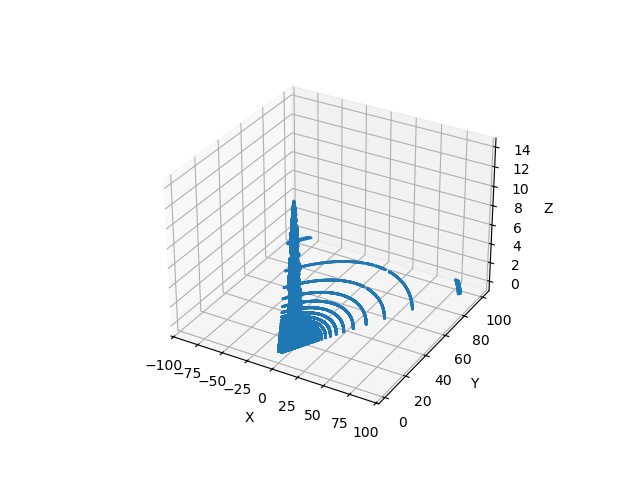

In [3]:
# plot the point clouds interactively
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(point_clouds[:,0], point_clouds[:,1], point_clouds[:,2], s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

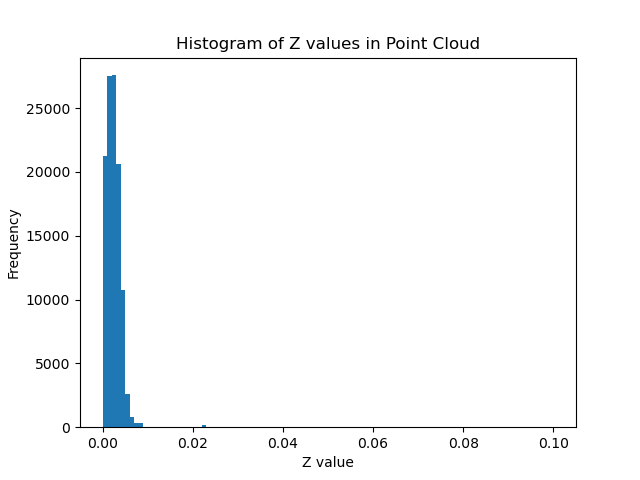

In [4]:
# remove all z points below a certain threshold (e.g., ground level)
# plot histogram of z values to determine threshold
# new plot
fig = plt.figure()
plt.hist(point_clouds[:,2], bins=100, range=(0, 0.1))
plt.xlabel('Z value')
plt.ylabel('Frequency')
plt.title('Histogram of Z values in Point Cloud')
plt.show()

Points after removing ground level: 30960


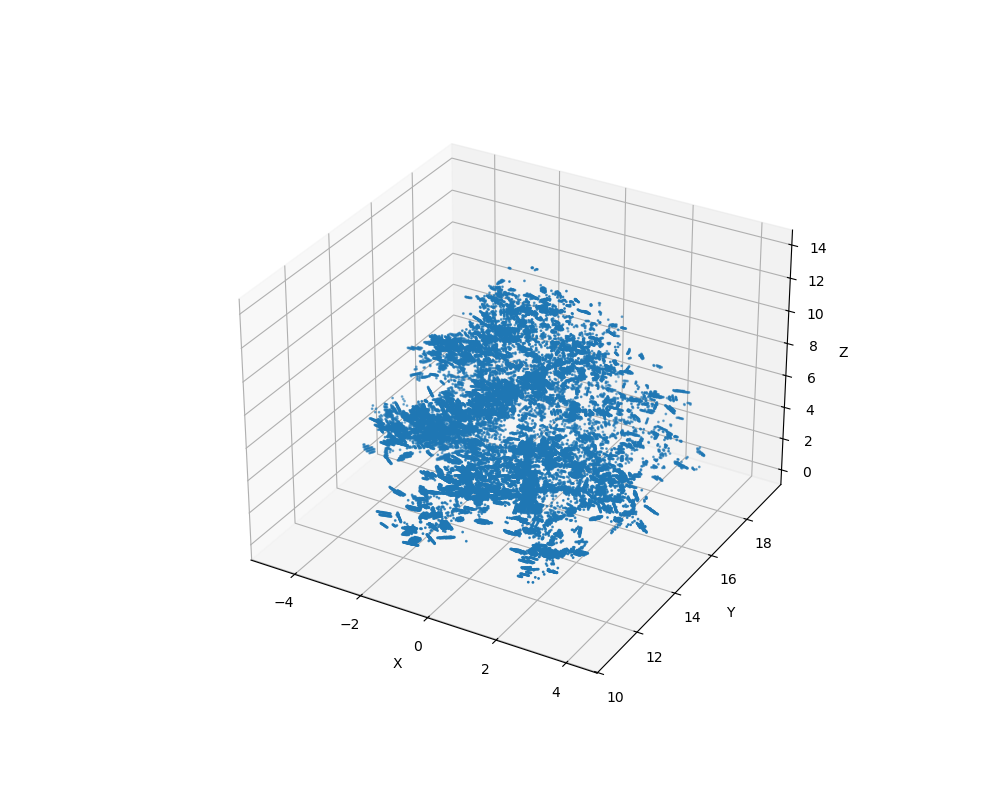

In [5]:
# remove all z_points below 0.02
z_threshold = 0.05
filtered_points = point_clouds[point_clouds[:,2] > z_threshold]
print(f"Points after removing ground level: {filtered_points.shape[0]}")    
# plot filtered point clouds
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(filtered_points[:,0], filtered_points[:,1], filtered_points[:,2], s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

# Keep only the tree half which faces the LiDAR scanner

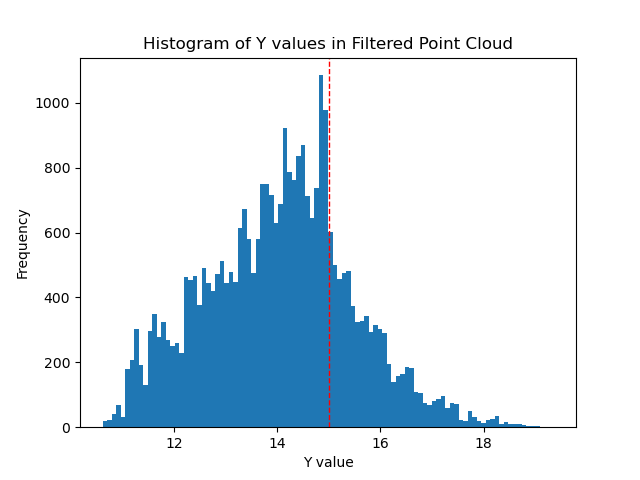

In [6]:
# plot histogram on Y values 
fig = plt.figure()
plt.hist(filtered_points[:,1], bins=100)
# plot mode
mode_y = 15
plt.axvline(mode_y, color='r', linestyle='dashed', linewidth=1)
plt.xlabel('Y value')
plt.ylabel('Frequency')
plt.title('Histogram of Y values in Filtered Point Cloud')
plt.show()

Points after removing high Y values: 24507


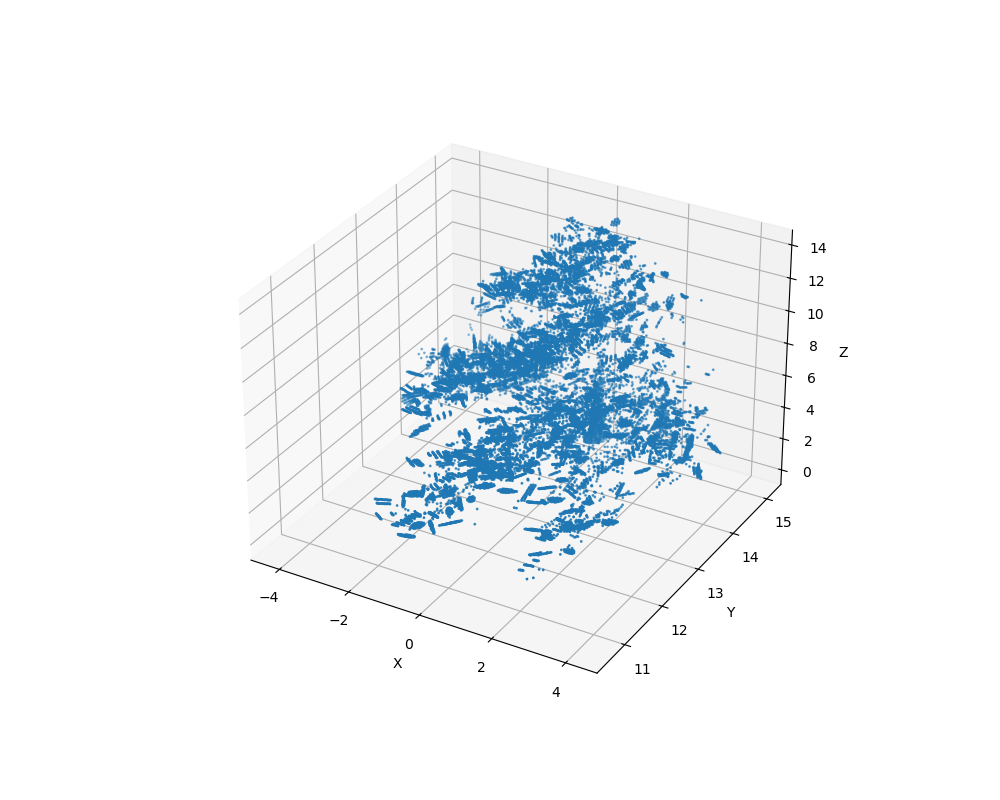

In [7]:
# filter out all points with y > mode_y
y_threshold = mode_y + 0.1 # add some margin in case some leaves get cut off
filtered_points = filtered_points[filtered_points[:,1] < y_threshold]
print(f"Points after removing high Y values: {filtered_points.shape[0]}")    
# plot final point clouds
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(filtered_points[:,0], filtered_points[:,1], filtered_points[:,2], s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.show()

Points after down sampling: 24507


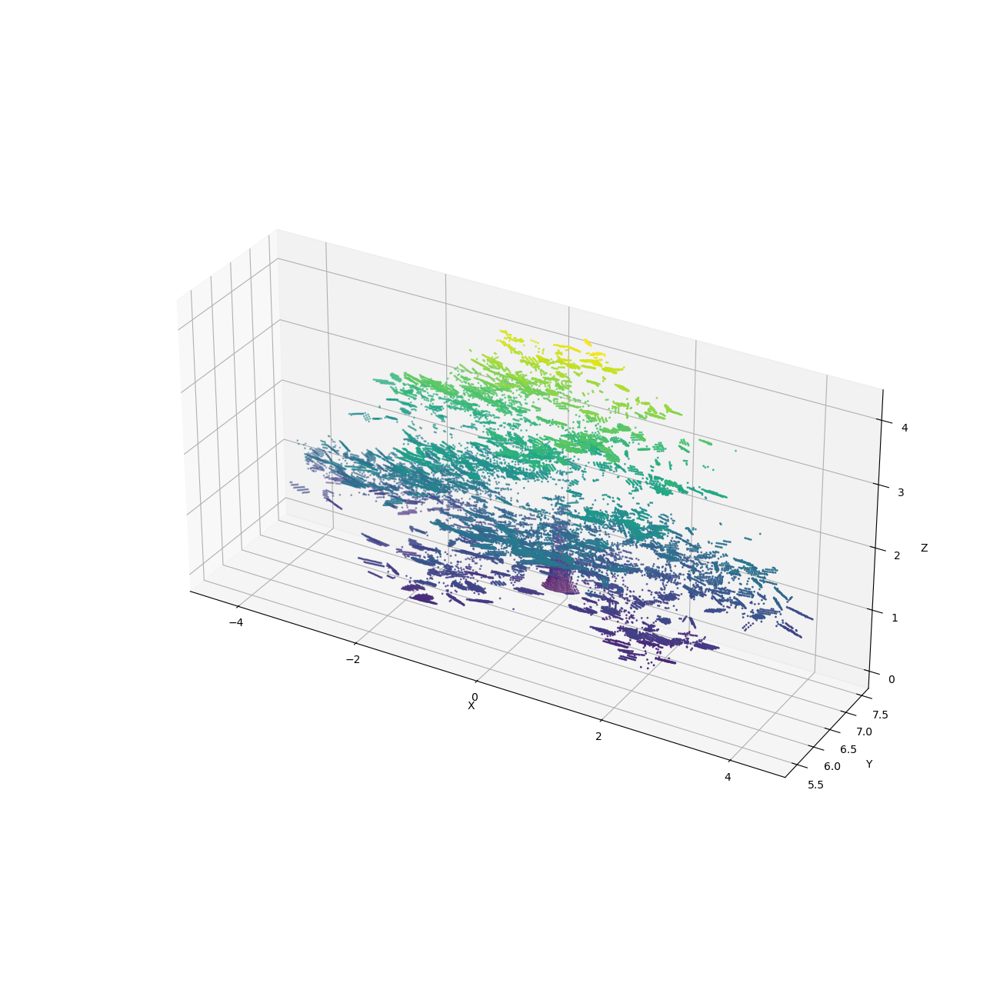

In [8]:
# down sampling the point clouds for faster processing
sample_ratio = 1  # keep 100% of points
num_points = filtered_points.shape[0]
sampled_indices = np.random.choice(num_points, size=int(num_points * sample_ratio), replace=False)
sampled_points = filtered_points[sampled_indices]

# compress the y values by 0.5 to make the point clouds denser in y direction
sampled_points[:,1] = sampled_points[:,1] * 0.5
# compress the z values by 0.7 to make the point clouds denser in z direction
sampled_points[:,2] = sampled_points[:,2] * 0.3

print(f"Points after down sampling: {sampled_points.shape[0]}")
# plot down sampled point clouds
fig = plt.figure(figsize=(13,13))
ax = fig.add_subplot(111, projection='3d')
# color by z value
sc = ax.scatter(sampled_points[:,0], sampled_points[:,1], sampled_points[:,2], c=sampled_points[:,2], cmap='viridis', s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
# make all axes the same scale
ax.set_aspect('equal', adjustable='box')
# plt.colorbar(sc, ax=ax, label='Z value', shrink=0.3)
plt.show()

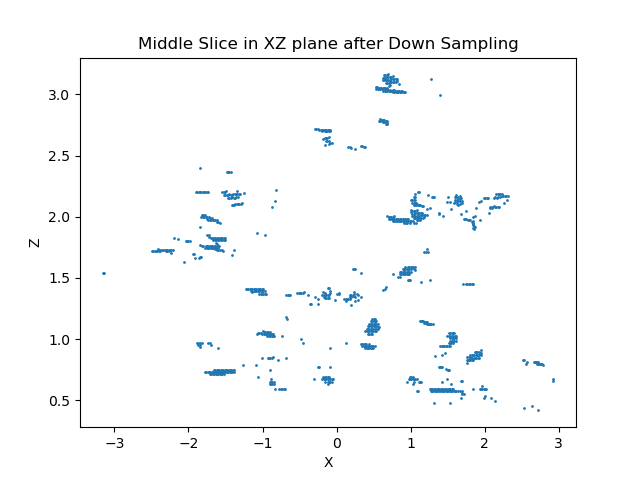

In [9]:
# check a slice in the middle
y_middle = (np.min(sampled_points[:,1]) + np.max(sampled_points[:,1])) / 2
slice_thickness = 0.1
middle_slice = sampled_points[(sampled_points[:,1] >= y_middle - slice_thickness/2) & (sampled_points[:,1] < y_middle + slice_thickness/2)]
plt.figure()
plt.scatter(middle_slice[:,0], middle_slice[:,2], s=1)
plt.title('Middle Slice in XZ plane after Down Sampling')
plt.xlabel('X')
plt.ylabel('Z')
plt.show()

# the slice looks good, the distance of points between the z and x direction are comparable now.

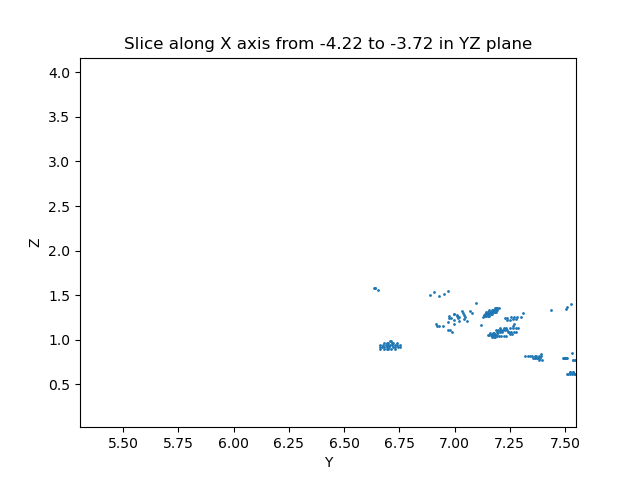

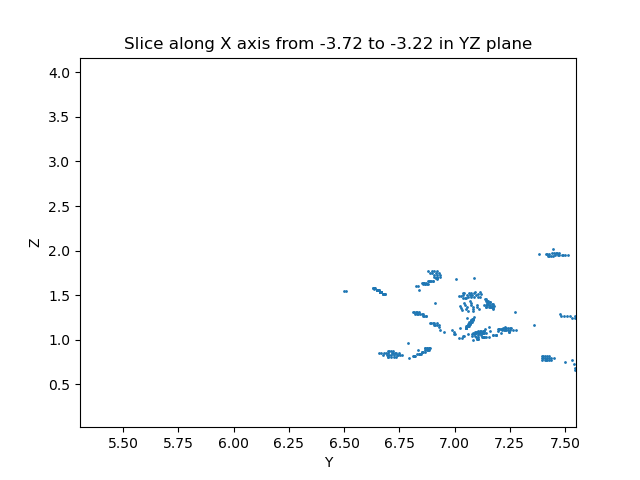

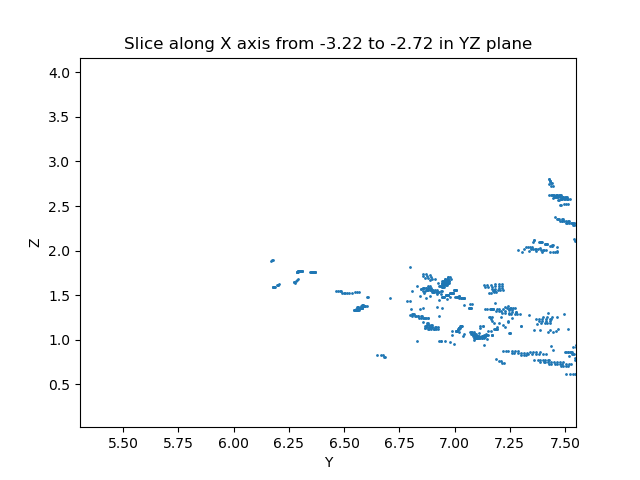

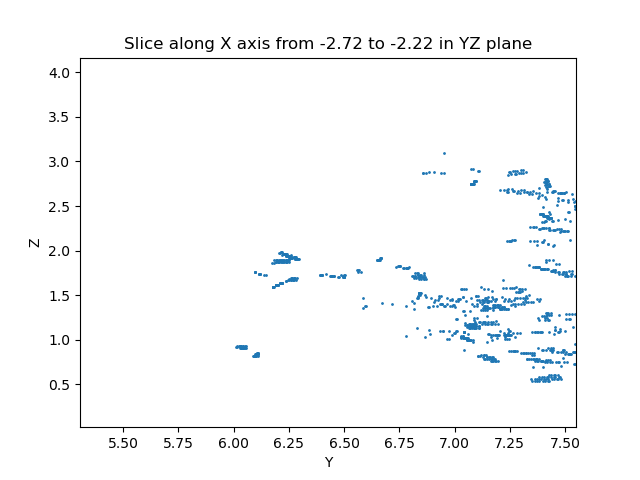

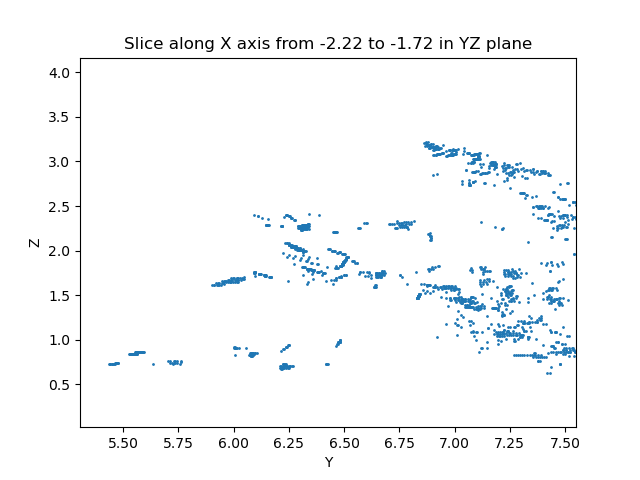

...

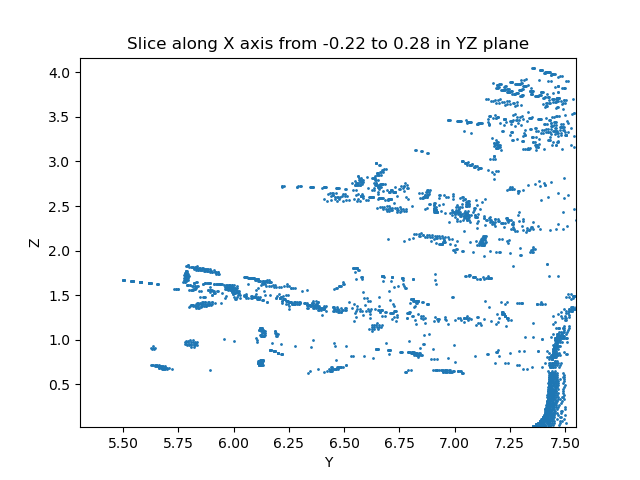

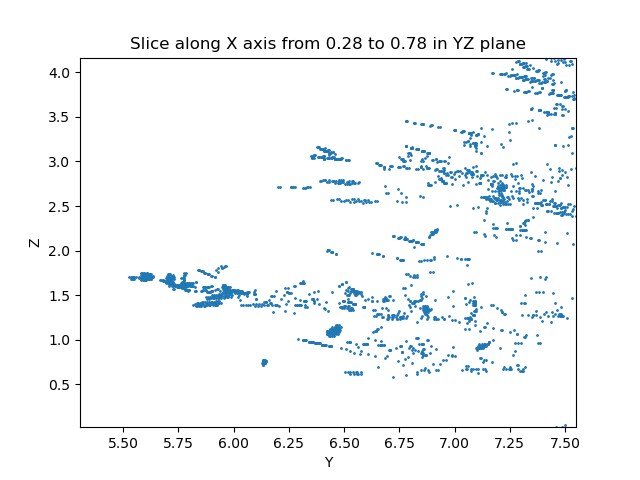

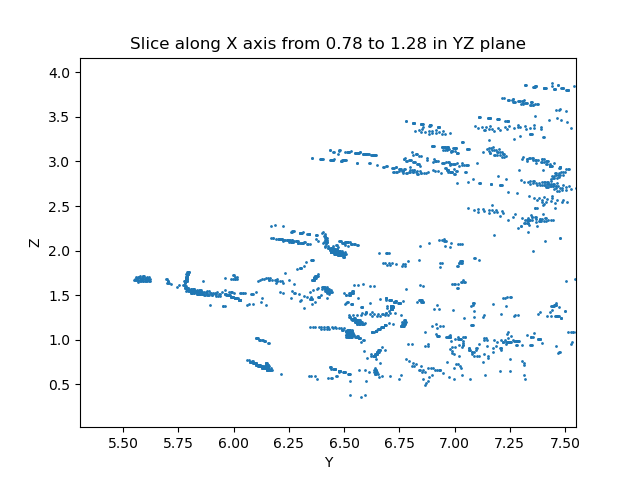

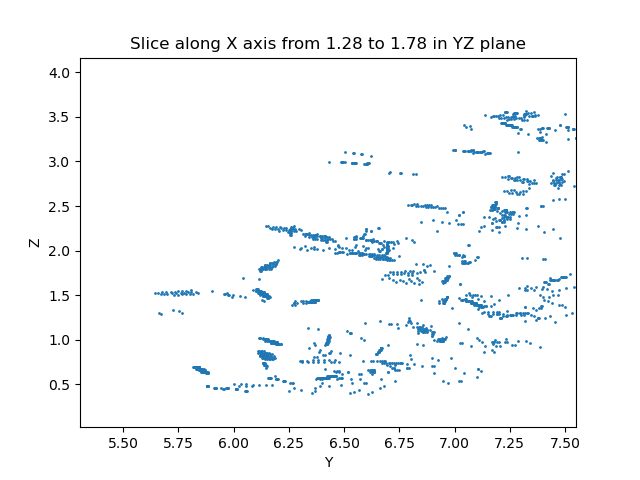

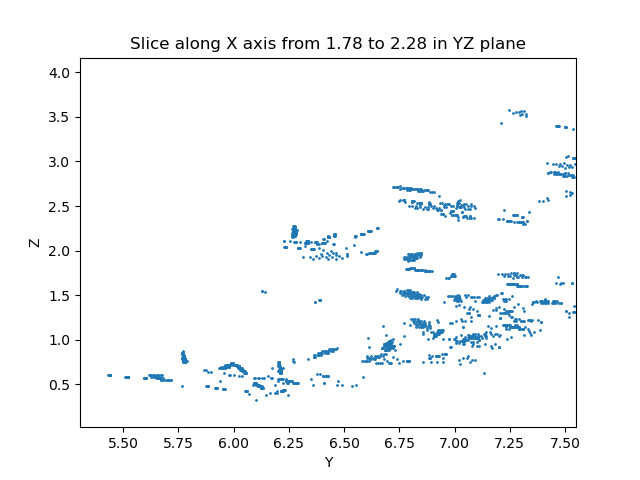

/tmp/ipykernel_1546968/2072953540.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


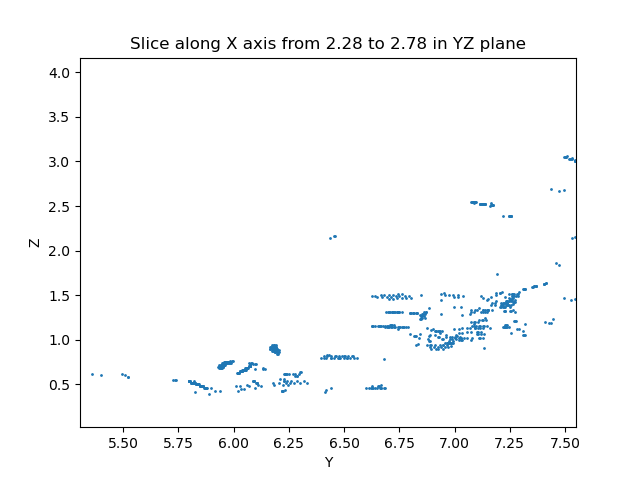

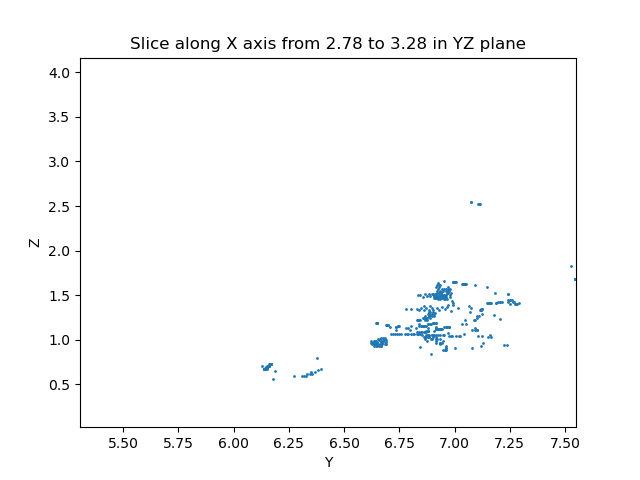

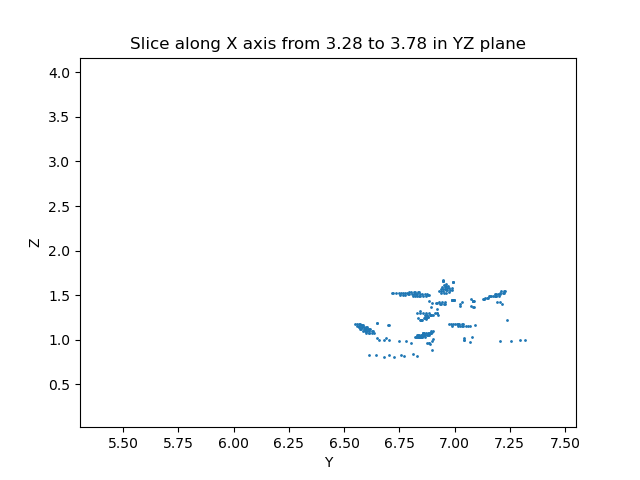

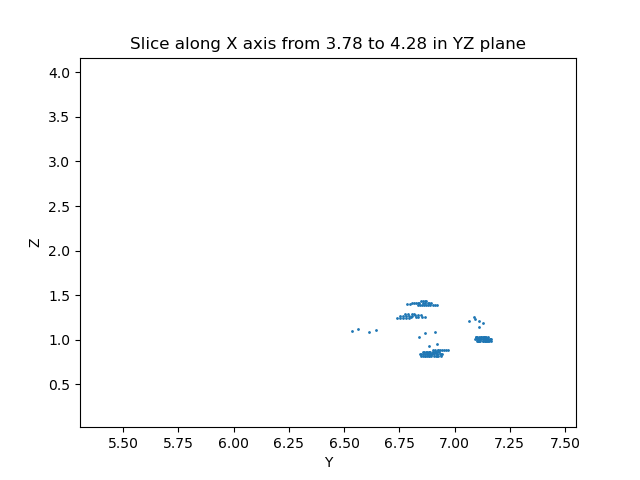

In [10]:
# show some slices along the x axis
x_min = np.min(sampled_points[:,0])
x_max = np.max(sampled_points[:,0])
slice_thickness = 0.5
x = x_min
while x < x_max:
    slice_points = sampled_points[(sampled_points[:,0] >= x) & (sampled_points[:,0] < x + slice_thickness)]
    plt.figure()
    plt.scatter(slice_points[:,1], slice_points[:,2], s=1)
    plt.title(f'Slice along X axis from {x:.2f} to {x + slice_thickness:.2f} in YZ plane')
    plt.xlabel('Y')
    plt.ylabel('Z')
    plt.xlim(np.min(sampled_points[:,1]), np.max(sampled_points[:,1]))
    plt.ylim(np.min(sampled_points[:,2]), np.max(sampled_points[:,2]))
    plt.show()
    x += slice_thickness
# we can see that it does well in some areas, but in some areas, leaves are still merged together or cut into different clusters.
# this is because

# Finding leaf clusters

We can see that the distance between points are not uniform across the tree. It is affected by:
1. The distance from the LiDAR scanner to the leaf surface.
2. The angle between the leaf surface normal and the direction from the LiDAR scanner to the leaf surface.

DBSCAN requires a fixed distance threshold (eps) to cluster points. Therefore, we will cut the tree into smaller clusters first, then apply DBSCAN on each smaller cluster with an appropriate eps value.

## Clustering the tree into smaller clusters

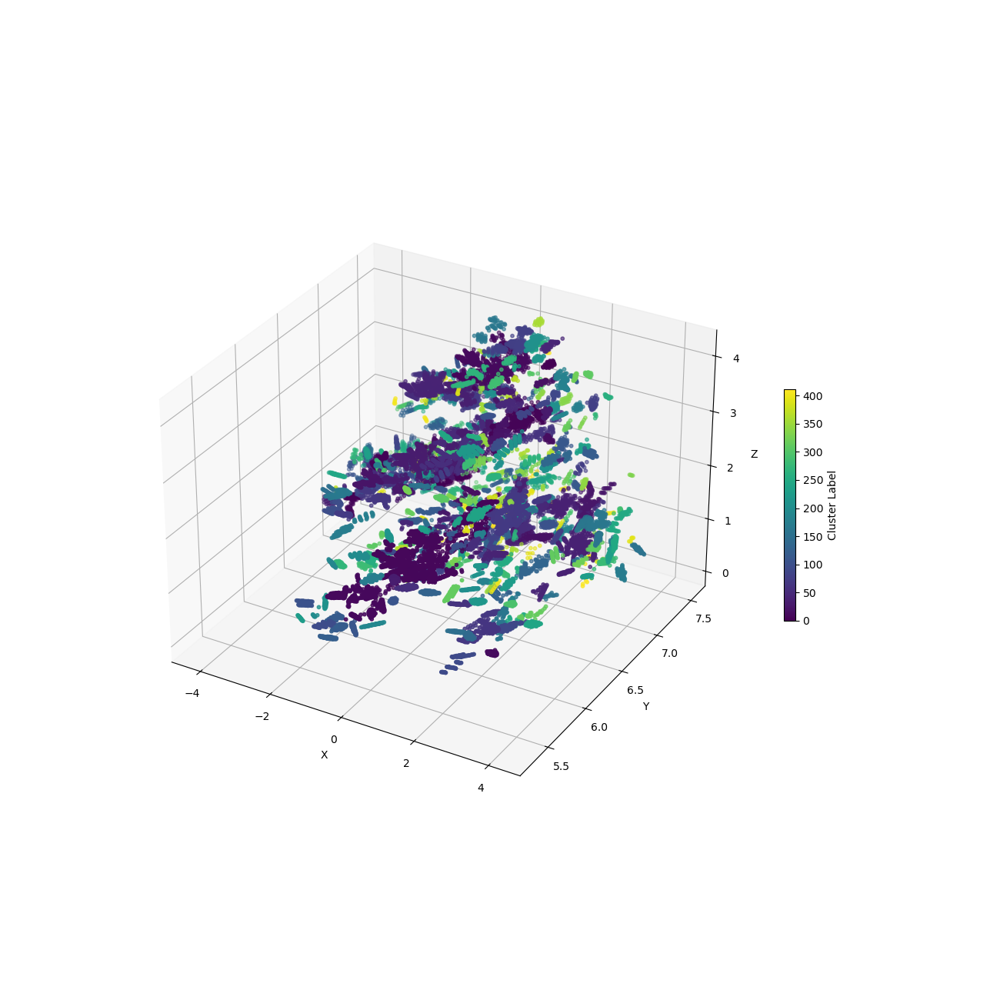

In [11]:
# use DBSCAN to create clusters of points (branches and leaves)
from sklearn.cluster import DBSCAN

# initial cluster
y_scale = 1
scaled_points = sampled_points.copy()
scaled_points[:,1] = scaled_points[:,1] * y_scale
eps = 0.08
dbscan = DBSCAN(eps=eps, min_samples=5, n_jobs=14)
labels = dbscan.fit_predict(scaled_points)
num_clusters = len(set(labels)) - (1 if -1 in labels else 0)

# plot clusters with different colors
fig = plt.figure(figsize=(13,13))
ax = fig.add_subplot(111, projection='3d')  
# remove points which belong to no cluster (label = -1)
valid_indices = labels != -1
sampled_points_plot = scaled_points[valid_indices]
labels_plot = labels[valid_indices] 
sc = ax.scatter(sampled_points_plot[:,0], sampled_points_plot[:,1], sampled_points_plot[:,2], c=labels_plot, cmap='viridis', s=10)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.colorbar(sc, ax=ax, label='Cluster Label', shrink=0.3)
plt.show()

## For each smaller cluster, find leaf clusters using DBSCAN, RANSAC and shape analysis

In [21]:

# for each large cluster, find the best y_scale, z_scale to maximize the number of leaf-like clusters

from sklearn.decomposition import PCA

# analyze the shape of clusters, we want the shape that characterize leaves best
def analyze_cluster_shape(points):
    """Analyze the shape of a cluster of points using PCA."""
    if points.shape[0] < 3:
        return 0.0, 0.0, 0.0  # not enough points to analyze shape
    
    # get linearality, planarity, sphericity
    pca = PCA(n_components=3)
    pca.fit(points)
    eigenvalues = pca.explained_variance_
    total_variance = np.sum(eigenvalues)
    linearity = (eigenvalues[0] - eigenvalues[1]) / total_variance
    planarity = (eigenvalues[1] - eigenvalues[2]) / total_variance
    sphericity = eigenvalues[2] / total_variance
    return linearity, planarity, sphericity

# leaf-like clusters are defined as clusters with size between certain sizes, and planarity > linearity and sphericity
def cluster_is_leaf_like(cluster_points, min_points=10, max_points=80, min_ratio=20):
    linearity, planarity, sphericity = analyze_cluster_shape(cluster_points)
    ratio = planarity / (sphericity + 1e-7)
    if cluster_points.shape[0] >= min_points and cluster_points.shape[0] <= max_points and ratio >= min_ratio:
        return True, linearity, planarity, sphericity
    return False, linearity, planarity, sphericity


def score_function(points, labels, min_points=10, max_points=80, min_ratio=20):
    cluster_id_2_stats = {}
    for cluster_label in set(labels):
        if cluster_label == -1:
            continue  # skip noise
        cluster_points = points[labels == cluster_label]
        is_leaf, linearity, planarity, sphericity = cluster_is_leaf_like(cluster_points, 
                                                                         min_points=min_points, 
                                                                         max_points=max_points, 
                                                                         min_ratio=min_ratio)
        if is_leaf:
            cluster_id_2_stats[cluster_label] = (linearity, planarity, sphericity)
            
    # score is planarity * number of points in each leaf-like cluster
    score = 0
    for cluster_label, stats in cluster_id_2_stats.items():
        # planarity = stats[1]
        num_points = np.sum(labels == cluster_label)
        score += num_points
    return score, cluster_id_2_stats


def DBSCAN_cluster_optimization(cluster_points, min_points=15, max_points=80, min_ratio=10, 
                                y_scale_min=0.5, y_scale_max=2.0, y_scale_step=0.2, 
                                z_scale_min=0.5, z_scale_max=2.0, z_scale_step=0.2):
    # try different y_scale and z_scale to scale the cluster points using DBSCAN to find subclusters
    # score the subclusters based on the number of leaf-like clusters found
    best_score = -1
    best_num_leaf_clusters = 0
    best_clustering = np.zeros(cluster_points.shape[0], dtype=int)
    is_leaf_label = np.zeros(cluster_points.shape[0], dtype=int)
    
    list_y_scale = np.arange(y_scale_min, y_scale_max, y_scale_step)
    list_z_scale = np.arange(z_scale_min, z_scale_max, z_scale_step)
    list_min_samples = [5]
    
    for min_samples in list_min_samples:
        for y_scale in list_y_scale:
            for z_scale in list_z_scale:
                scaled_points = cluster_points.copy()
                scaled_points[:,1] = scaled_points[:,1] * y_scale
                scaled_points[:,2] = scaled_points[:,2] * z_scale
                
                dbscan = DBSCAN(eps=0.05, min_samples=min_samples, n_jobs=16)
                labels = dbscan.fit_predict(scaled_points)
                
                # the number of points in -1 cluster should be less than 20% of total points
                num_noise_points = np.sum(labels == -1)
                if num_noise_points > 0.2 * scaled_points.shape[0]:
                    continue  # skip this scale
                
                score, cluster_id_2_stats = score_function(scaled_points, labels, min_points=min_points, 
                                                           max_points=max_points, min_ratio=min_ratio)
                
                if score > best_score or (np.abs(score - best_score) <= 5 and len(cluster_id_2_stats) > best_num_leaf_clusters):
                    best_score = score
                    best_num_leaf_clusters = len(cluster_id_2_stats)
                    best_clustering = labels
                    is_leaf_label = np.array([0 if labels[i] == -1 else 1 for i in range(labels.shape[0])], dtype=bool)
                    
    return best_score, best_num_leaf_clusters, best_clustering, is_leaf_label


# implementing sequential RANSAC to find 2d leaf planes in 3d point clouds
from sklearn.linear_model import RANSACRegressor
def find_leaf_planes_ransac(cluster_points, distance_threshold=0.01, min_inliers=20):
    remaining_points = cluster_points.copy()
    leaf_planes = []
    
    list_len_remaining = []
    while remaining_points.shape[0] >= min_inliers:
        # fit RANSAC plane model
        ransac = RANSACRegressor(residual_threshold=distance_threshold, min_samples=3, max_trials=200)
        X = remaining_points[:, :2]  # use x and y as input
        y = remaining_points[:, 2]    # use z as output
        ransac.fit(X, y)
        
        inlier_mask = ransac.inlier_mask_
        inlier_points = remaining_points[inlier_mask]
        
        # there can be multiple cluster in inlier points so we want to separate them
        # use DBSCAN to separate them, find the best DBSCAN clustering and remove good clusters.
        best_score, best_num_leaf_clusters, best_clustering, is_leaf_label = DBSCAN_cluster_optimization(inlier_points,
                                                                                                       min_points=10, 
                                                                                                       max_points=80, 
                                                                                                       min_ratio=10,
                                                                                                       y_scale_min=0.5, y_scale_max=2.0, y_scale_step=0.2, 
                                                                                                       z_scale_min=0.5, z_scale_max=2.0, z_scale_step=0.2)
        
        # print(is_leaf_label)
        # print(len(inlier_points))
        # print(len(is_leaf_label))
        # set inlier_points to only those points that are labeled as leaf-like clusters
        inlier_points = inlier_points[is_leaf_label]
        
        for cluster_id in range(best_num_leaf_clusters):
            cluster_points = inlier_points[best_clustering[is_leaf_label] == cluster_id]
            if cluster_points.shape[0] >= min_inliers:
                leaf_planes.append(cluster_points)
                
        # set inlier_mask to only those points that are labeled as leaf-like clusters
        # is_leaf_label is a subset of inlier_mask
        # for place where inlier_mask is True, we need to set it to is_leaf_label
        new_inlier_mask = np.zeros(inlier_mask.shape[0], dtype=bool)
        new_inlier_mask[inlier_mask] = is_leaf_label
        inlier_mask = new_inlier_mask
            
        # remove inliers from remaining points
        outlier_mask = np.logical_not(inlier_mask)
        remaining_points = remaining_points[outlier_mask]
        
        len_remaining = remaining_points.shape[0]
        list_len_remaining.append(len_remaining)
        # if 3 time and still no change, break
        if len(list_len_remaining) >= 5:
            if all(x == list_len_remaining[-1] for x in list_len_remaining[-3:]):
                break
    
    return leaf_planes



def optimize_scales_for_cluster(cluster_points):
    """
    This function should return the best subclustering labels for the given cluster points
    1. Try different y_scale and z_scale to scale the cluster points using DBSCAN to find subclusters
    2. Score the subclusters based on the number of leaf-like clusters found
    3. If number of leaf-like clusters is 0, try sequential RANSAC to find leaf planes
    4. Return the best clustering assignment.
    """
    
    best_score, best_num_leaf_clusters, best_clustering, is_leaf_label = DBSCAN_cluster_optimization(cluster_points,
                                                                                                   min_points=15, 
                                                                                                   max_points=80, 
                                                                                                   min_ratio=10)
                    
    print(f"After DBSCAN: Best Score: {best_score}, Best Number of leaf-like clusters: {best_num_leaf_clusters}")
                    
    # in case best_num_leaf_clusters is 0, try with sequential RANSAC
    best_leaf_planes = []
    scaled_points = cluster_points.copy()
    leaf_planes = find_leaf_planes_ransac(scaled_points, distance_threshold=0.015, min_inliers=15)
    
    # for each leaf plane, check if it is leaf-like
    valid_leaf_planes = []
    for plane in leaf_planes:
        is_leaf, _, _, _ = cluster_is_leaf_like(plane, min_points=10, max_points=80, min_ratio=20)
        if is_leaf:
            valid_leaf_planes.append(plane)
    
    # score is total number of points in leaf planes
    score = sum(plane.shape[0] for plane in valid_leaf_planes)
    
    if score > best_score or (np.abs(score - best_score) <= 5 and len(valid_leaf_planes) > best_num_leaf_clusters):
        best_score = score
        best_num_leaf_clusters = len(valid_leaf_planes)
        best_leaf_planes = valid_leaf_planes
        
            
        # translate best_leaf_planes to best_clustering
        if len(best_leaf_planes) > 0:
            best_clustering = -1 * np.ones(cluster_points.shape[0], dtype=int)
            cluster_id = 0
            for plane in best_leaf_planes:
                for point in plane:
                    # find index of point in cluster_points
                    indices = np.where((cluster_points == point).all(axis=1))[0]
                    for index in indices:
                        best_clustering[index] = cluster_id
                cluster_id += 1
            is_leaf_label = [0 if best_clustering[i] == -1 else 1 for i in range(best_clustering.shape[0])]
            
    print(f"After RANSAC: Best Score: {best_score}, Best Number of leaf-like clusters: {best_num_leaf_clusters}")
                
                
    return best_score, best_num_leaf_clusters, best_clustering, is_leaf_label

In [22]:
cluster_id_2_best_scales = {}

In [23]:
for cluster_label in set(labels):
    if cluster_label in cluster_id_2_best_scales:
        continue  # already processed
    
    if cluster_label == -1:
        continue  # skip noise
    cluster_points = scaled_points[labels == cluster_label]
    
    best_score, best_num_leaf_clusters, best_clustering, is_leaf_label = optimize_scales_for_cluster(cluster_points)
    print(f"Cluster {cluster_label}: Best Score (leaf-like clusters): {best_score}, Number of leaf-like clusters: {best_num_leaf_clusters}")
    cluster_id_2_best_scales[cluster_label] = (best_score, best_num_leaf_clusters, best_clustering, is_leaf_label)

After DBSCAN: Best Score: 33, Best Number of leaf-like clusters: 1
After RANSAC: Best Score: 33, Best Number of leaf-like clusters: 1
Cluster 0: Best Score (leaf-like clusters): 33, Number of leaf-like clusters: 1
After DBSCAN: Best Score: 59, Best Number of leaf-like clusters: 2
After RANSAC: Best Score: 59, Best Number of leaf-like clusters: 2
Cluster 1: Best Score (leaf-like clusters): 59, Number of leaf-like clusters: 2
After DBSCAN: Best Score: 117, Best Number of leaf-like clusters: 3
After RANSAC: Best Score: 117, Best Number of leaf-like clusters: 3
Cluster 2: Best Score (leaf-like clusters): 117, Number of leaf-like clusters: 3
After DBSCAN: Best Score: 49, Best Number of leaf-like clusters: 1
After RANSAC: Best Score: 49, Best Number of leaf-like clusters: 1
Cluster 3: Best Score (leaf-like clusters): 49, Number of leaf-like clusters: 1
After DBSCAN: Best Score: 178, Best Number of leaf-like clusters: 7
After RANSAC: Best Score: 178, Best Number of leaf-like clusters: 7
Clust

In [24]:
# # plot some random clusters with their best scales
# for cluster_label in np.random.choice(list(cluster_id_2_best_scales.keys()), size=5, replace=False):
#     best_score, best_num_leaf_clusters, best_clustering, is_leaf_label = cluster_id_2_best_scales[cluster_label]
#     print(f"Cluster {cluster_label}: Best Score (leaf-like clusters): {best_score}, Number of leaf-like clusters: {best_num_leaf_clusters}")
#     cluster_points = scaled_points[labels == cluster_label]
    
#     # plot clusters with different colors
#     large_cluster = cluster_points.copy()
#     sub_labels = best_clustering
    
#     fig = plt.figure(figsize=(10,10))
#     ax = fig.add_subplot(111, projection='3d')
#     valid_indices = sub_labels != -1
#     sampled_points_plot = large_cluster[valid_indices]
#     labels_plot = sub_labels[valid_indices]
#     sc = ax.scatter(sampled_points_plot[:,0], sampled_points_plot[:,1], sampled_points_plot[:,2], c=labels_plot, cmap='viridis', s=10)
#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     ax.set_zlabel('Z')
#     # plot true scale 
#     ax.set_aspect('equal', adjustable='box')
#     plt.tight_layout()
#     plt.show()

In [25]:
# # plot some non leaf clusters
# for cluster_label in np.random.choice(list(cluster_id_2_best_scales.keys()), size=20, replace=False):
#     best_score, best_num_leaf_clusters, best_clustering, is_leaf_label = cluster_id_2_best_scales[cluster_label]
#     if best_num_leaf_clusters > 0:
#         continue  # skip leaf-like clusters
#     print(f"Cluster {cluster_label}: Best Score (leaf-like clusters): {best_score}, Number of leaf-like clusters: {best_num_leaf_clusters}")
#     cluster_points = scaled_points[labels == cluster_label]
    
#     # plot clusters with different colors
#     large_cluster = cluster_points.copy()
#     sub_labels = best_clustering
    
#     fig = plt.figure(figsize=(10,10))
#     ax = fig.add_subplot(111, projection='3d')
#     valid_indices = sub_labels != -1
#     sampled_points_plot = large_cluster[valid_indices]
#     labels_plot = sub_labels[valid_indices]
#     sc = ax.scatter(sampled_points_plot[:,0], sampled_points_plot[:,1], sampled_points_plot[:,2], c=labels_plot, cmap='viridis', s=10)
#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     ax.set_zlabel('Z')
#     # plot true scale 
#     ax.set_aspect('equal', adjustable='box')
#     plt.tight_layout()
#     plt.show()

In [ ]:
# assert False

In [26]:
# dump cluster_id_2_best_scales to a file
import pickle
with open('cluster_id_2_best_scales_v9.pkl', 'wb') as f:
    pickle.dump(cluster_id_2_best_scales, f)
    
# dump all points and their cluster labels to a file
import pandas as pd
df = pd.DataFrame(scaled_points, columns=['X', 'Y', 'Z'])
df['ClusterLabel'] = labels
df.to_csv('scaled_points_with_clusters_v9.csv', index=False)

# # load cluster_id_2_best_scales from a file
# import pickle
# with open('cluster_id_2_best_scales_v8.pkl', 'rb') as f:
#     cluster_id_2_best_scales = pickle.load(f)
    
# # load all points and their cluster labels from a file
# import pandas as pd
# df = pd.read_csv('scaled_points_with_clusters_v8.csv')
# scaled_points = df[['X', 'Y', 'Z']].values
# labels = df['ClusterLabel'].values  

# Visualize the final result

In [27]:
# add sub-cluster labels to the main labels but origianl labels * 10 + sub-cluster labels
new_labels = labels.copy()
is_leaf_label = np.zeros_like(labels, dtype=bool)
for cluster_label in set(labels):
    if cluster_label == -1:
        continue  # skip noise
    cluster_points = scaled_points[labels == cluster_label]
    
    if cluster_label not in cluster_id_2_best_scales:
        continue  # skip clusters that were not processed
    best_score, best_num_leaf_clusters, best_clustering, is_leaf_label_sub = cluster_id_2_best_scales[cluster_label]
    
    large_cluster = cluster_points.copy()
    sub_labels = best_clustering
    
    for i, point in enumerate(cluster_points):
        global_index = np.where((scaled_points == point).all(axis=1))[0][0]
        if sub_labels[i] == -1:
            continue  # skip noise
        new_labels[global_index] = cluster_label * 100 + sub_labels[i]
        is_leaf_label[global_index] = is_leaf_label_sub[i]

In [28]:
unique_labels = np.unique(new_labels)
num_unique_labels = len(unique_labels) - (1 if -1 in unique_labels else 0)
# generate a random map between unique labels and colors
label_to_color = {}
for label in unique_labels:
    if label == -1:
        label_to_color[label] = (0, 0, 0)  # black for noise
    else:
        label_to_color[label] = np.random.rand(3,)

In [29]:
# revert to original scales
orig_points = scaled_points.copy()
orig_points[:,1] = scaled_points[:,1] / 0.5
orig_points[:,2] = scaled_points[:,2] / 0.3

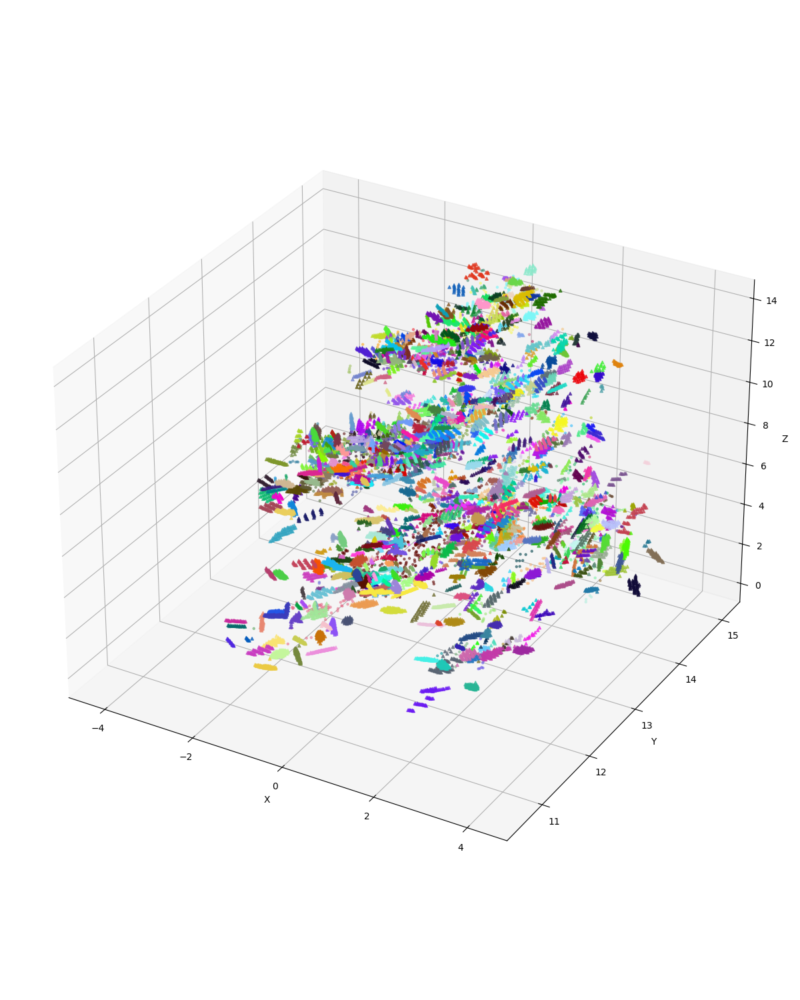

In [30]:
# plot tree using new labels
fig = plt.figure(figsize=(12,15))
ax = fig.add_subplot(111, projection='3d')  
# remove points which belong to no cluster (label = -1)
valid_indices = new_labels != -1
sampled_points_plot = orig_points[valid_indices]
labels_plot = new_labels[valid_indices] 
colors_plot = np.array([label_to_color[label] for label in labels_plot])
# plot leaf points as triangles
leaf_indices = is_leaf_label[valid_indices]
non_leaf_indices = ~leaf_indices
ax.scatter(sampled_points_plot[non_leaf_indices,0], sampled_points_plot[non_leaf_indices,1], sampled_points_plot[non_leaf_indices,2], c=colors_plot[non_leaf_indices], s=5, alpha=0.5)
ax.scatter(sampled_points_plot[leaf_indices,0], sampled_points_plot[leaf_indices,1], sampled_points_plot[leaf_indices,2], c=colors_plot[leaf_indices], s=10, marker='^', alpha=0.7)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.tight_layout()
plt.show()

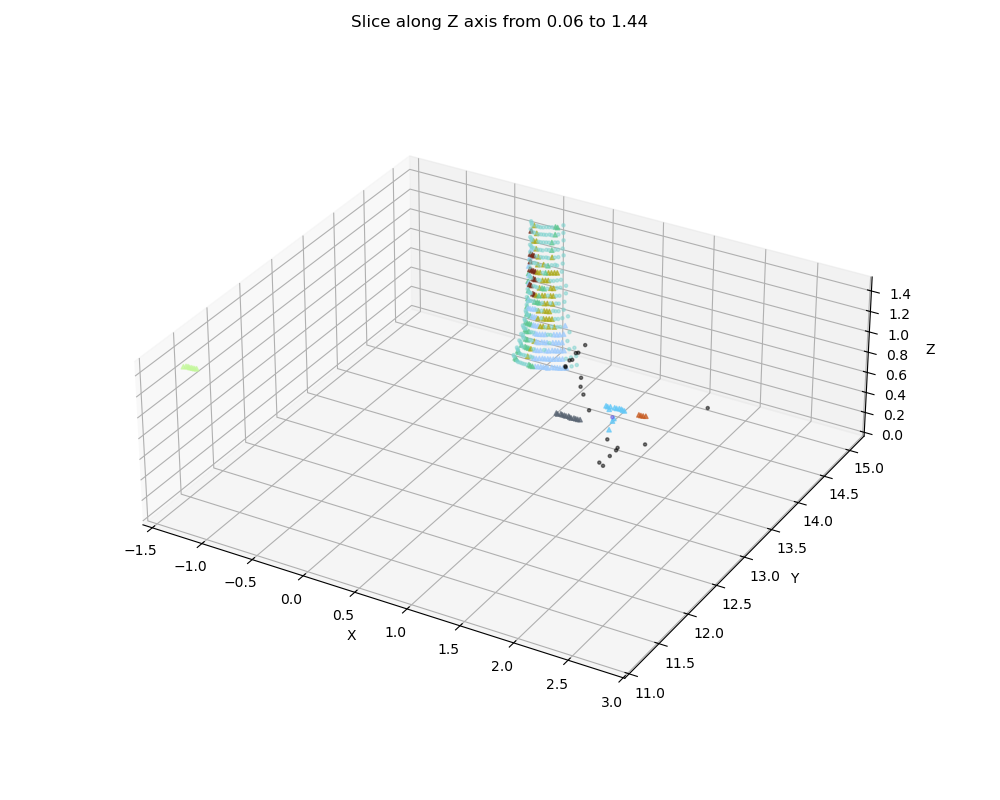

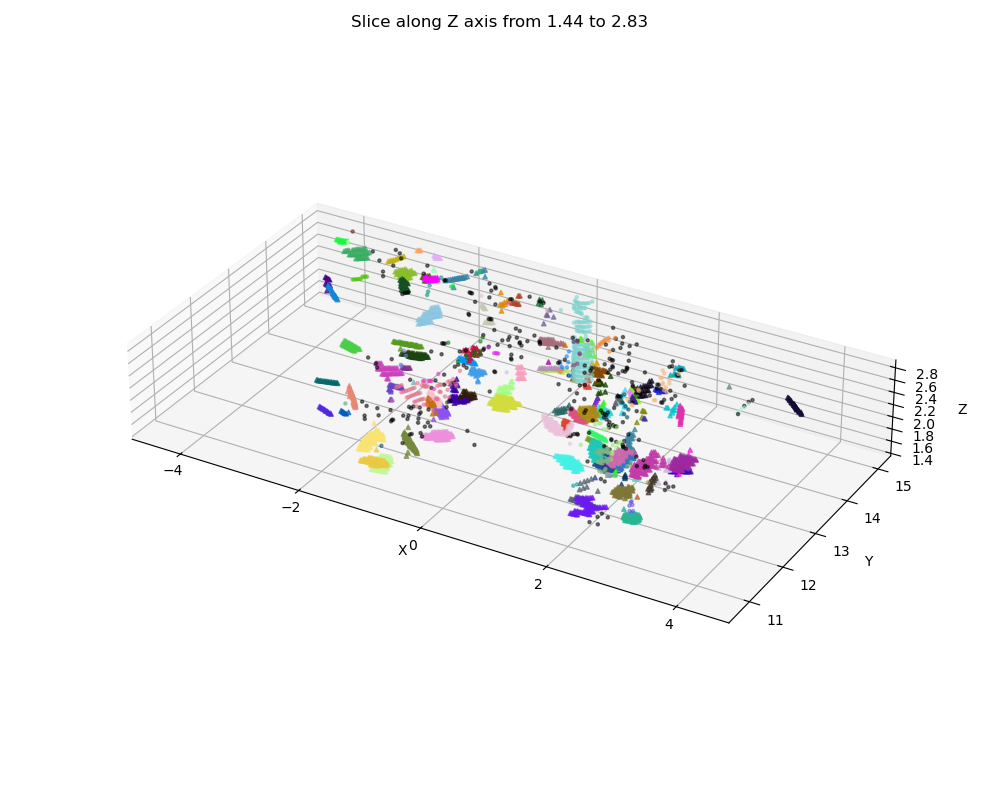

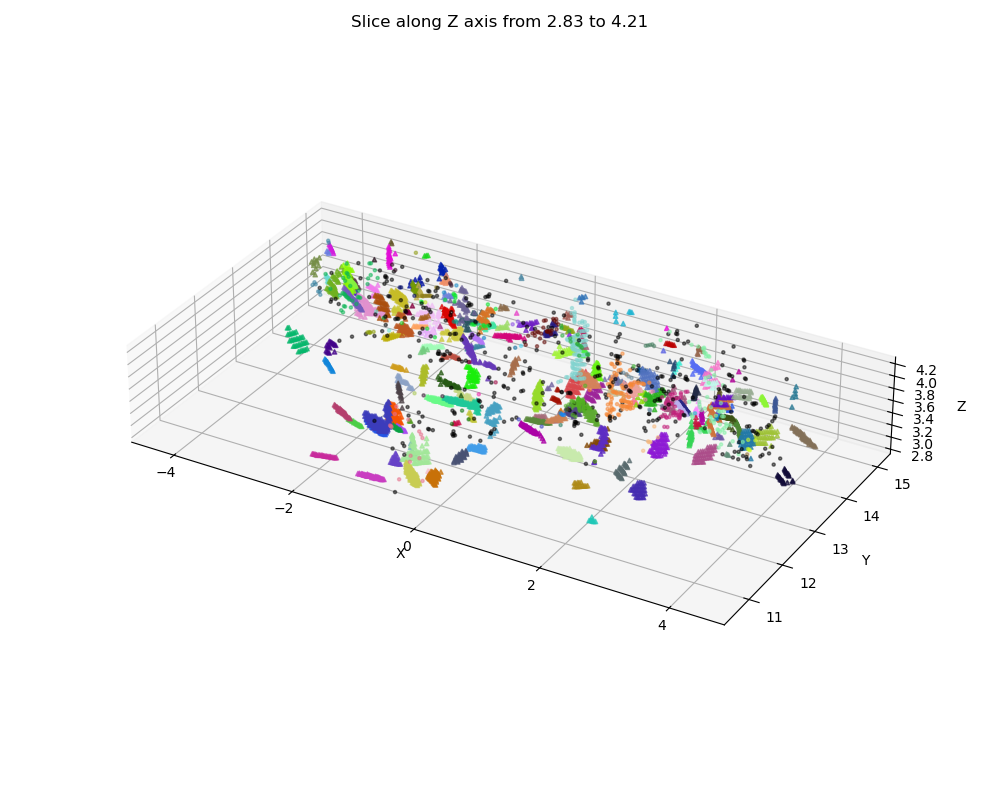

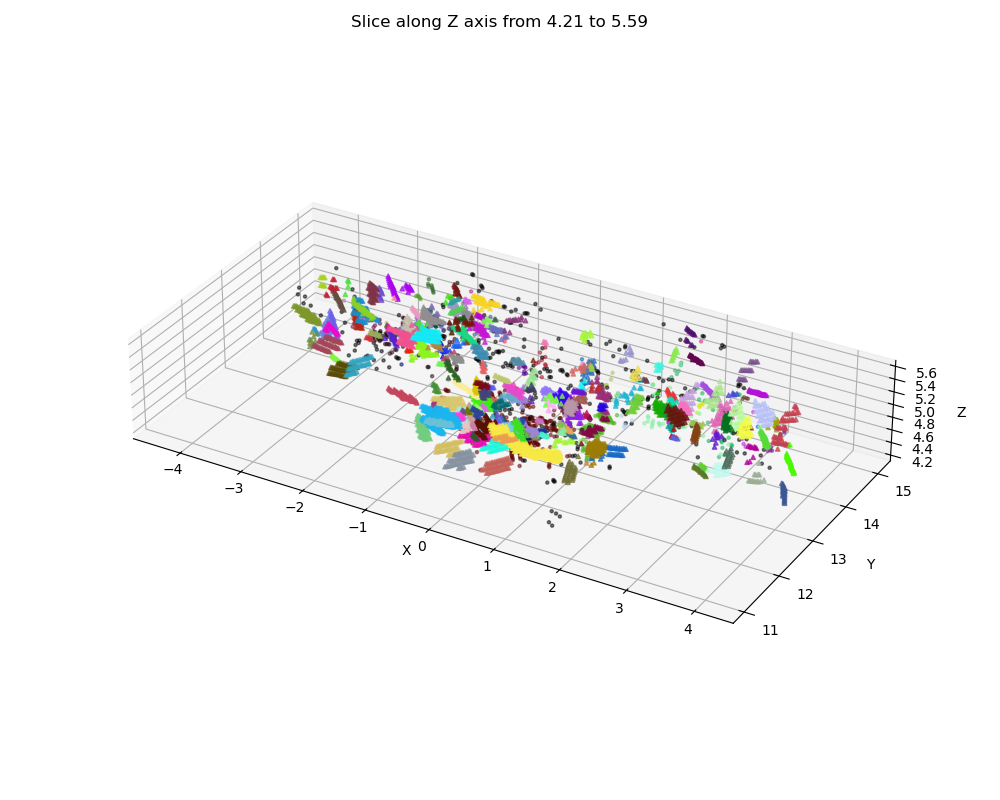

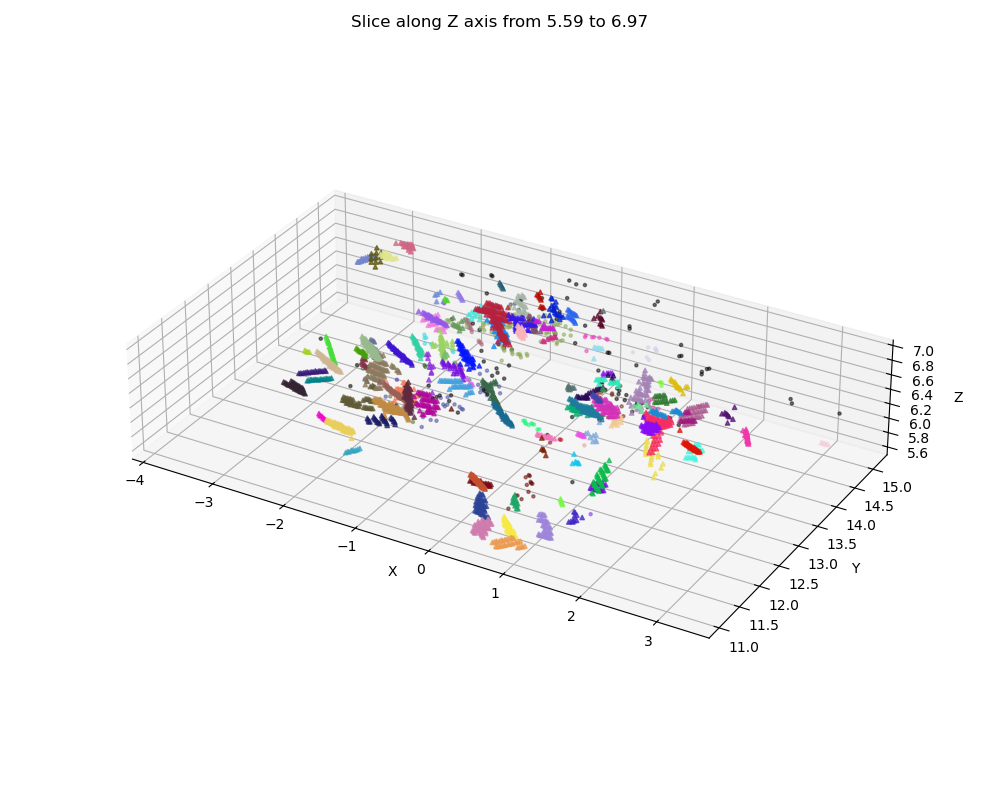

...

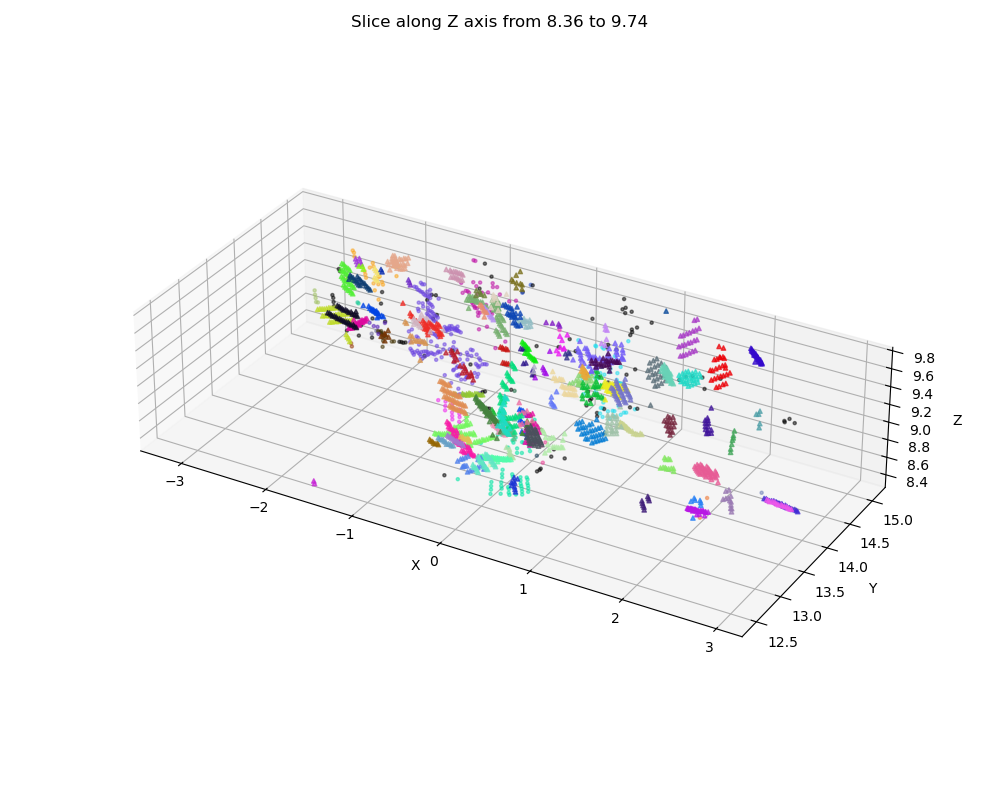

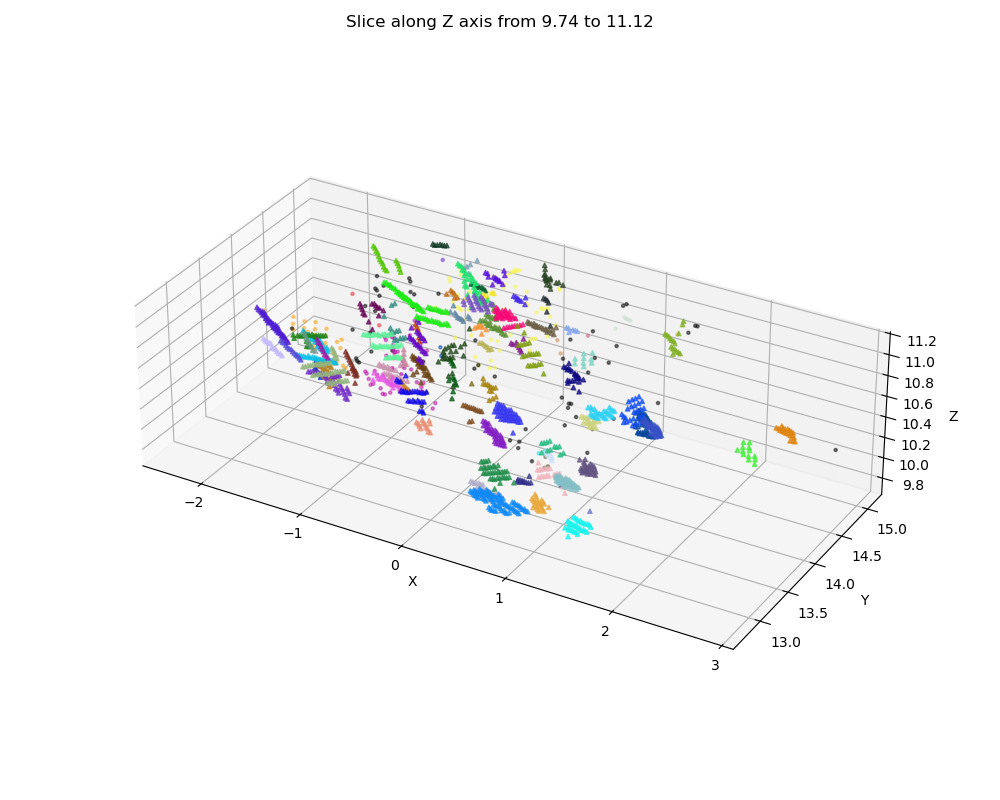

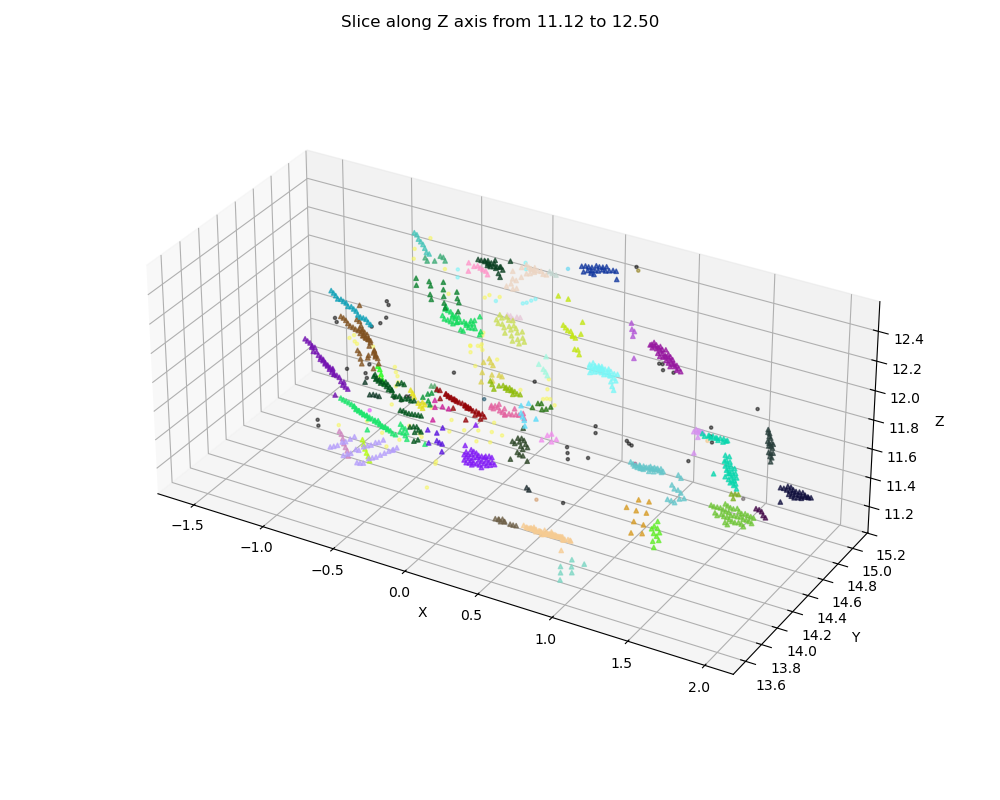

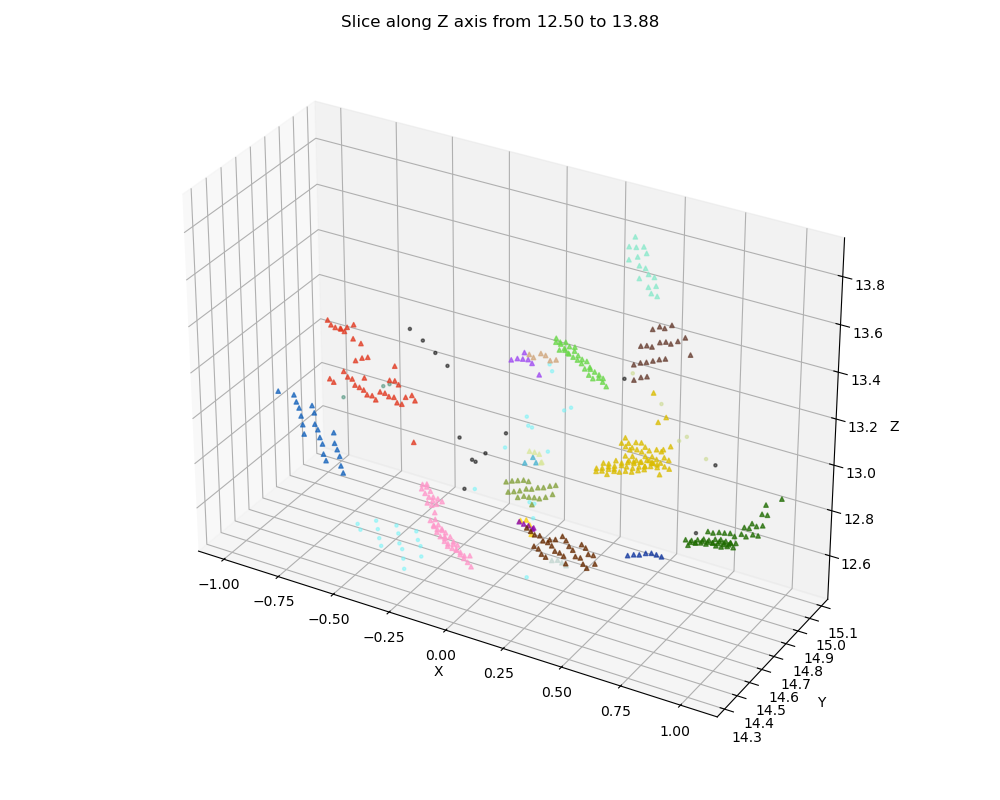

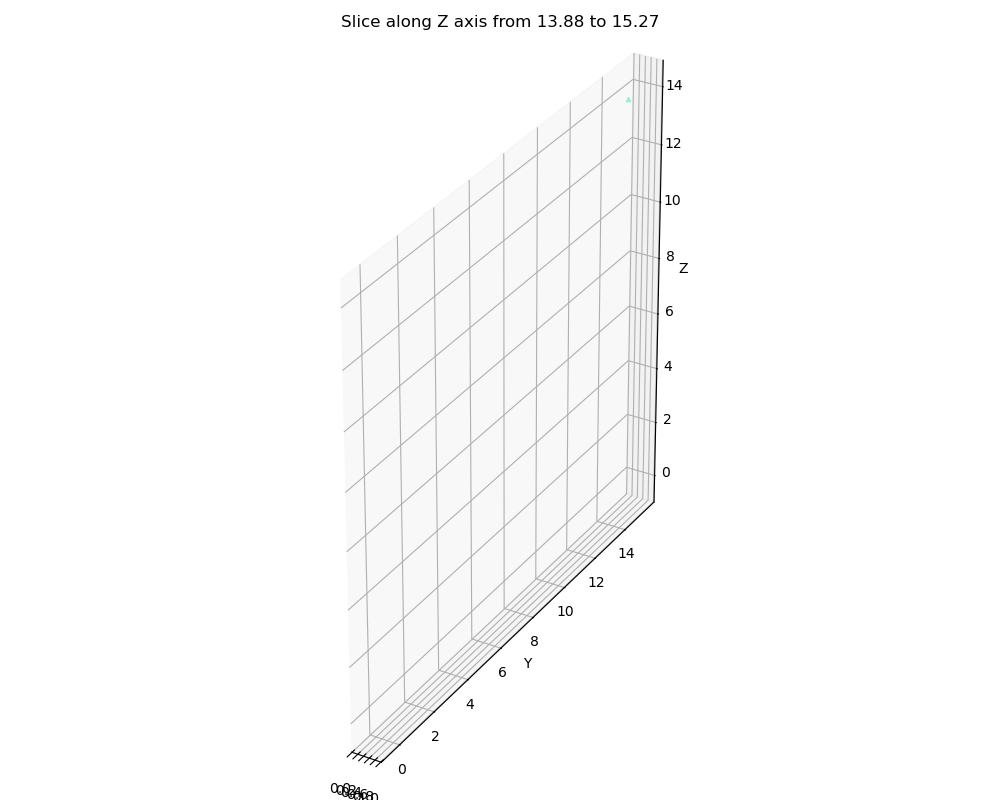

In [31]:
# plot 5 slices along the z axis, in 3d
z_min = np.min(orig_points[:,2])
z_max = np.max(orig_points[:,2])
slice_thickness = (z_max - z_min) / 10
z = z_min
while z < z_max:
    # plot in 3d
    slice_points = orig_points[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    slice_labels = new_labels[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    slice_colors = np.array([label_to_color[label] for label in slice_labels])
    is_leaf_label_slice = is_leaf_label[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111, projection='3d')  
    # plot leaf by triagle
    ax.scatter(slice_points[~is_leaf_label_slice,0], slice_points[~is_leaf_label_slice,1], slice_points[~is_leaf_label_slice,2], c=slice_colors[~is_leaf_label_slice], s=5, alpha=0.5)
    ax.scatter(slice_points[is_leaf_label_slice,0], slice_points[is_leaf_label_slice,1], slice_points[is_leaf_label_slice,2], c=slice_colors[is_leaf_label_slice], s=10, marker='^', alpha=0.7)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_aspect('equal', adjustable='box')
    plt.title(f'Slice along Z axis from {z:.2f} to {z + slice_thickness:.2f}')
    plt.tight_layout()
    plt.show()
    z += slice_thickness

In [ ]:
assert False

AssertionError: 

## Our estimation of number of leaves

In [32]:
# number of leaf clusters found is total number of num_leaf_cluster in cluster_id_2_best_scales
num_leaf = 0
for k, v in cluster_id_2_best_scales.items():
    num_leaf += v[1]
print(f"Estimated total number of leaves: {num_leaf*2}") # because we estimate on half of the point clouds

Estimated total number of leaves: 884


In [ ]:
# assert False

## CT scan along z-axis

Triangle points is for leaf clusters and circle points is for branch clusters.

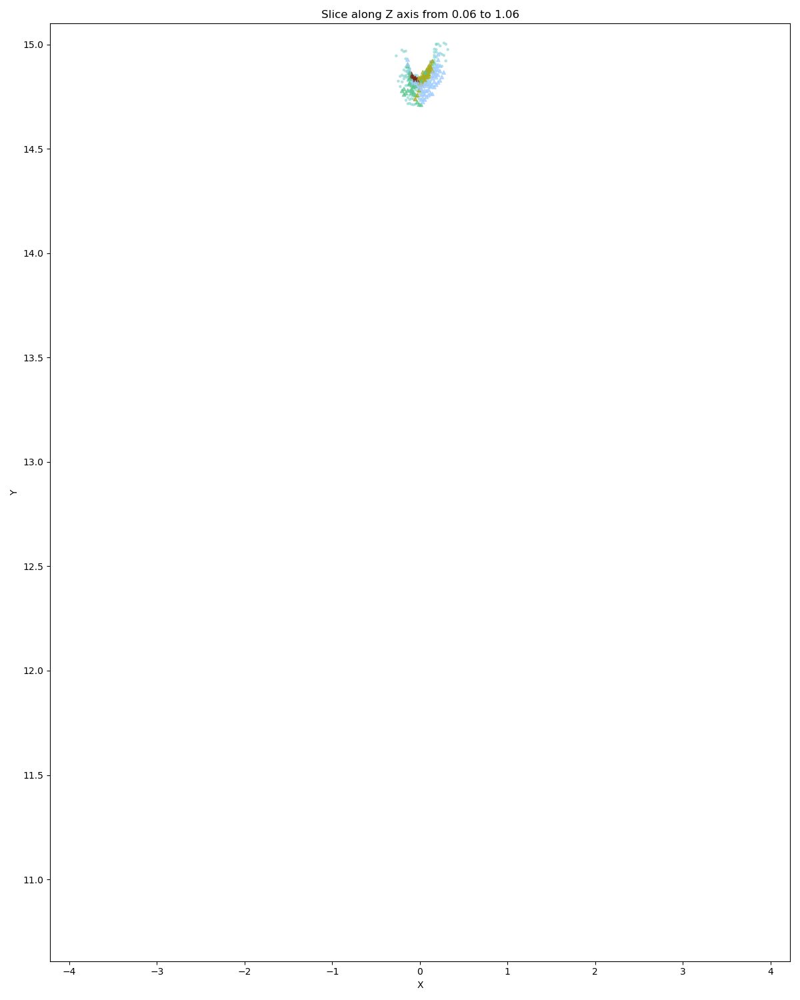

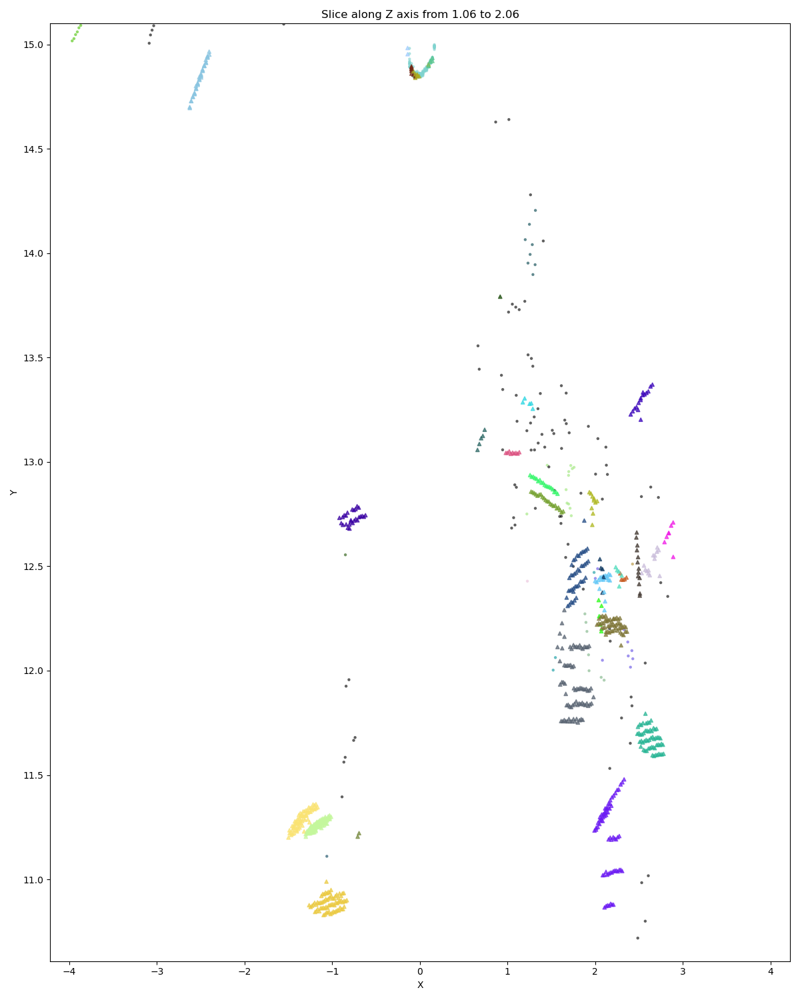

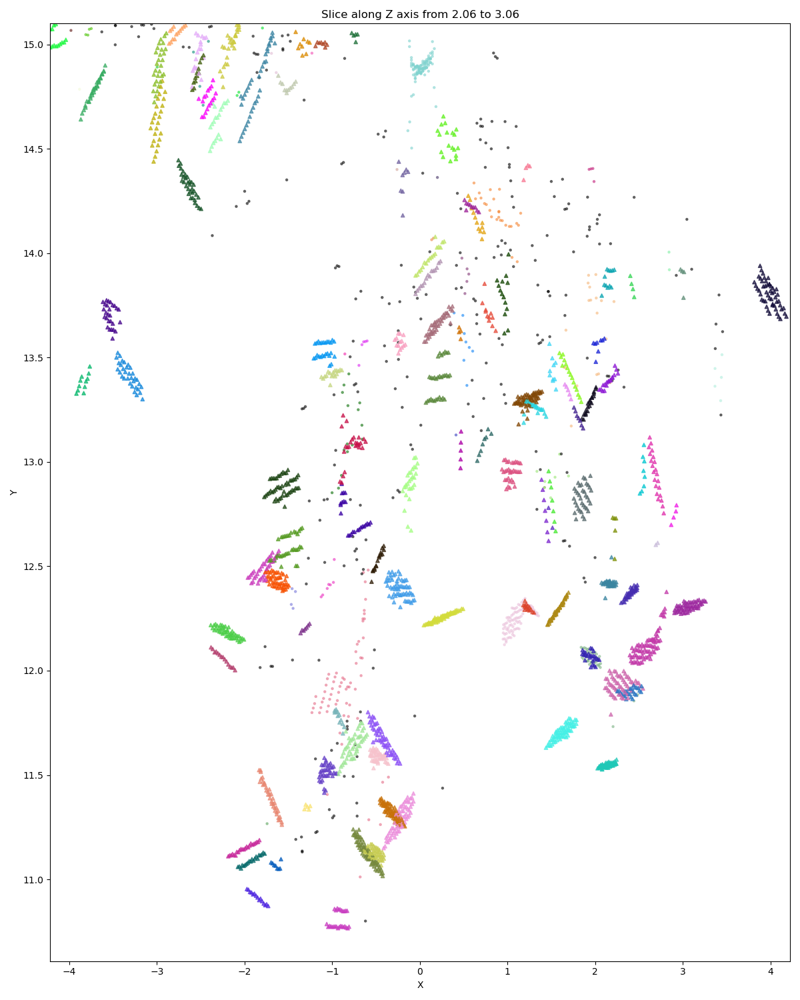

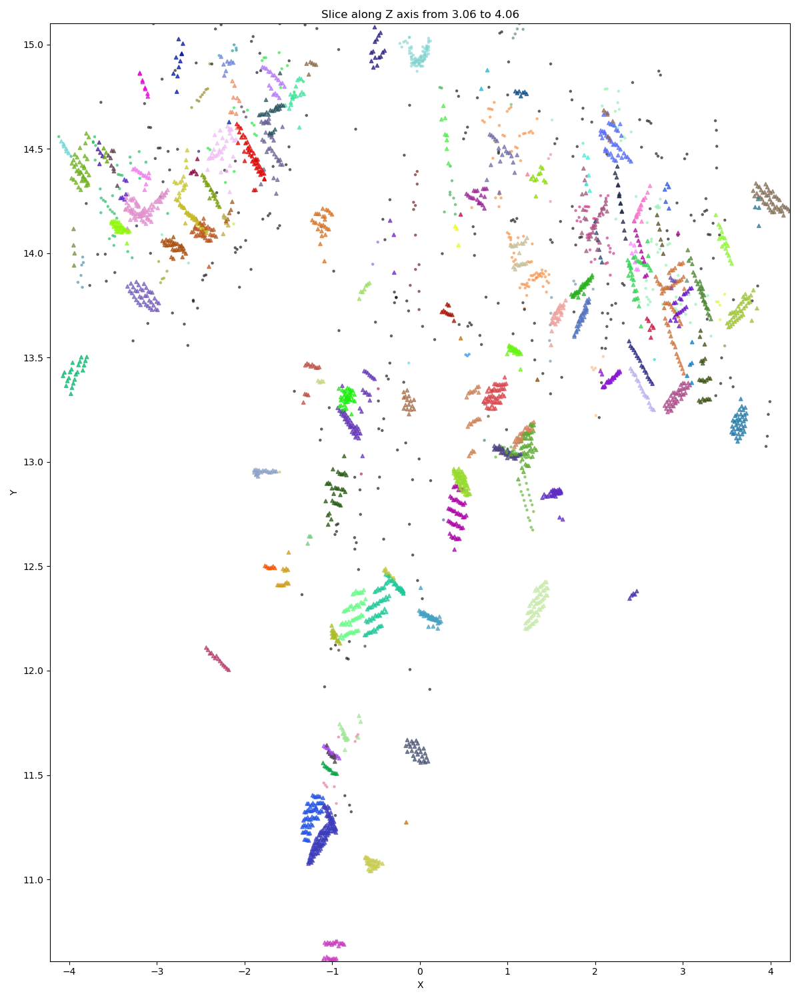

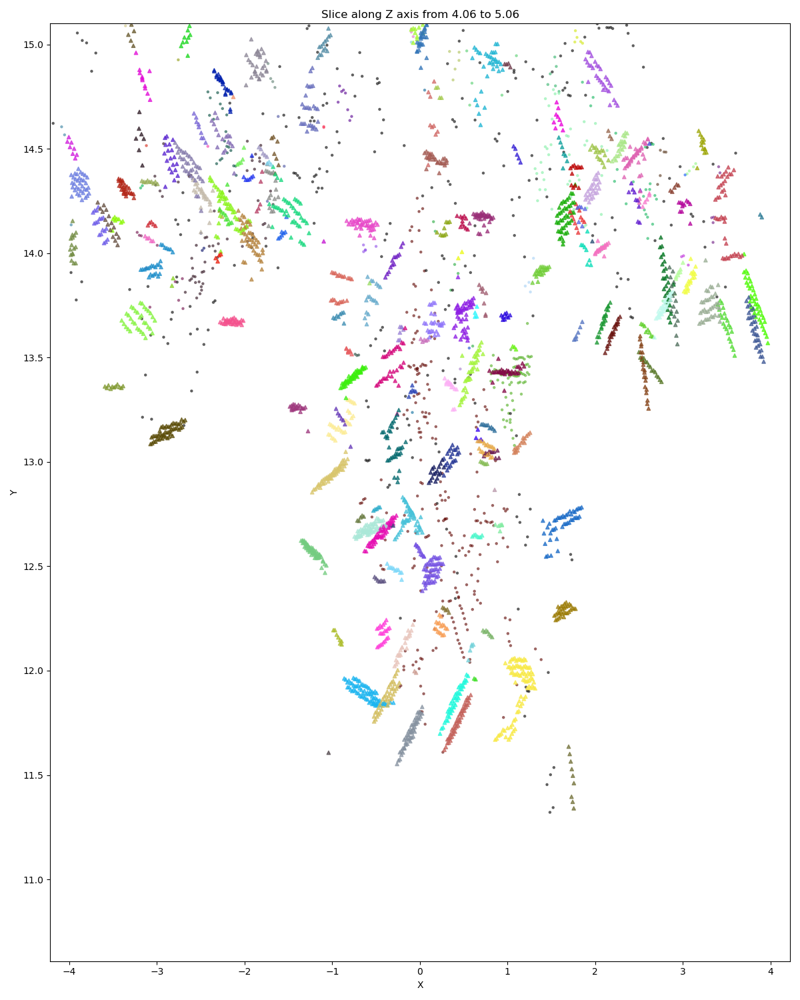

...

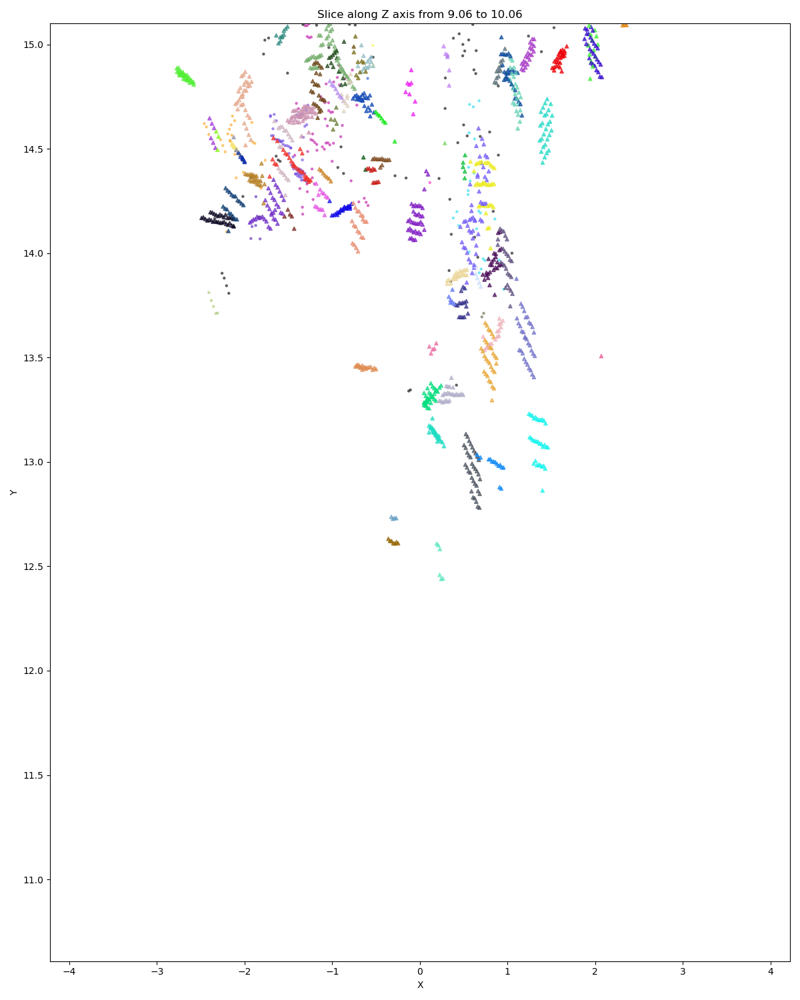

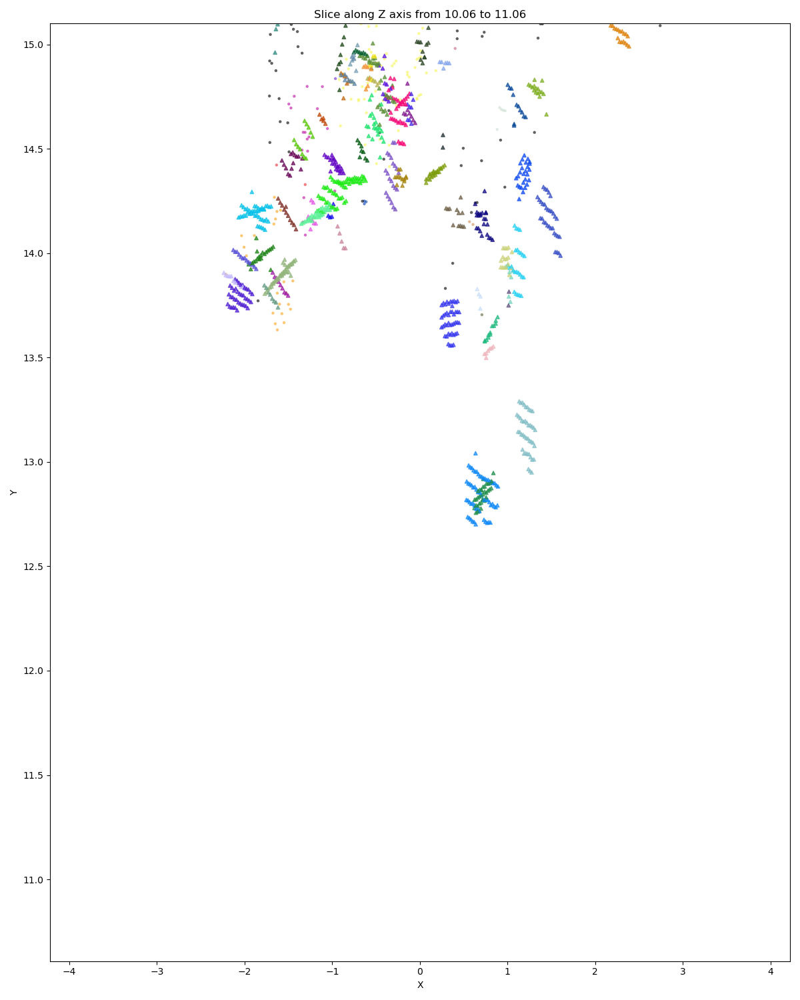

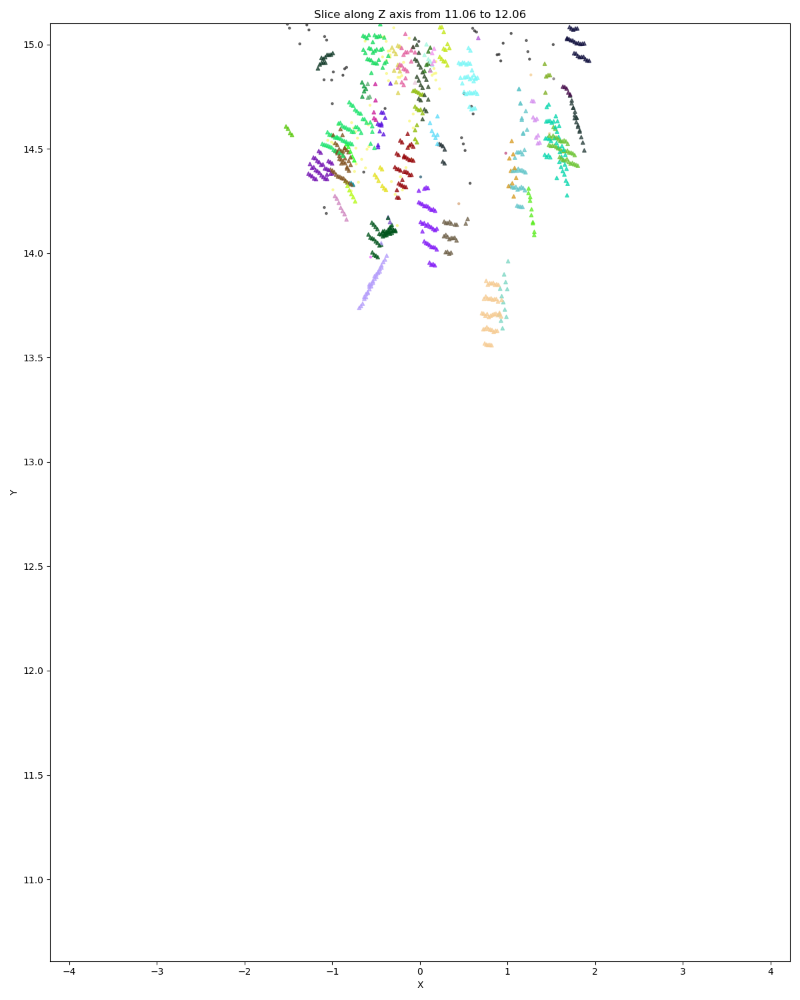

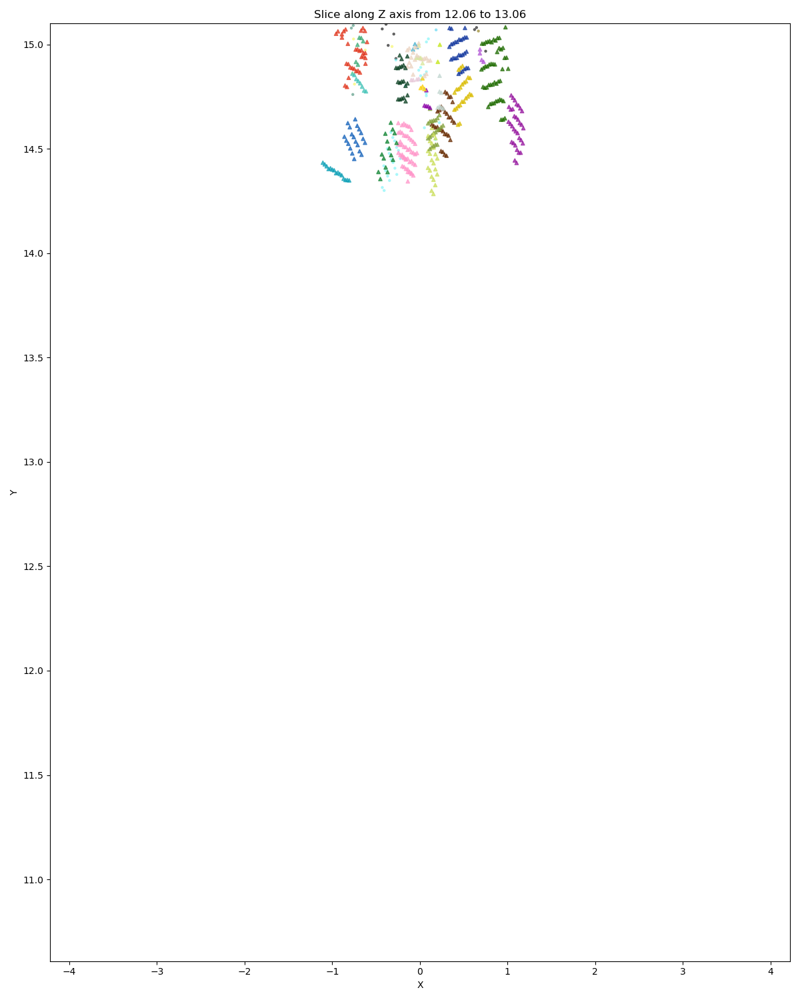

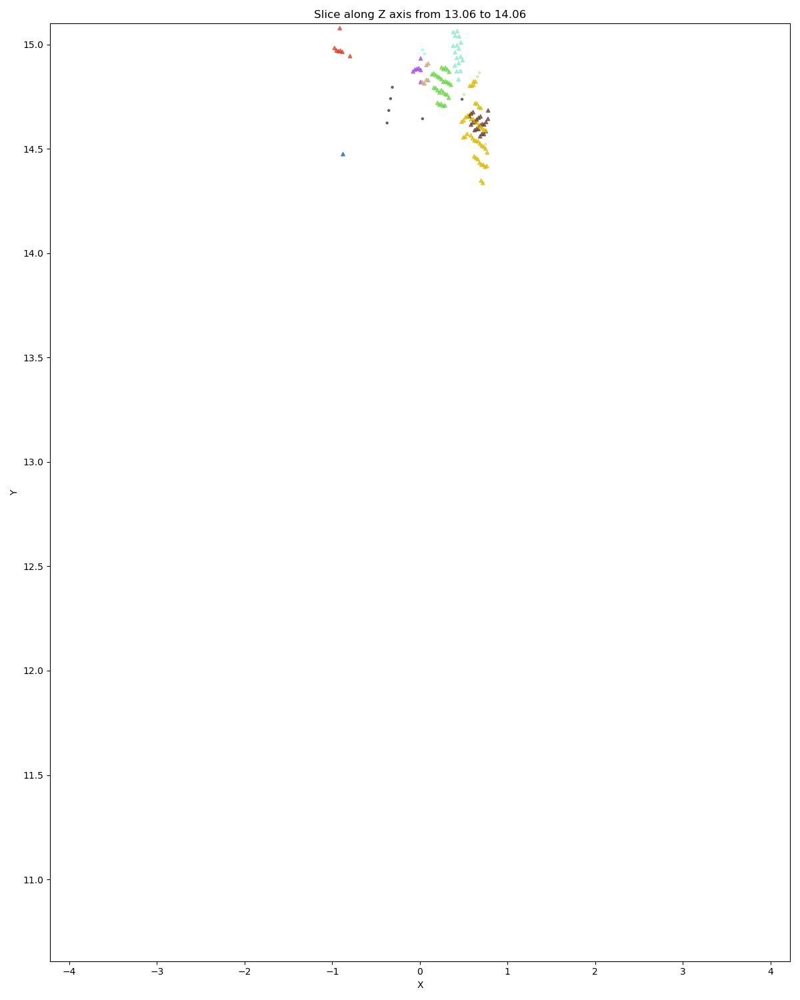

In [33]:
#  plot the tree cutting along the z axis at different heights
z_min = np.min(orig_points[:,2])
z_max = np.max(orig_points[:,2])
slice_thickness = 0.30 / 0.3  # original thickness before scaling
z = z_min
while z < z_max:
    slice_points = orig_points[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    slice_labels = new_labels[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    slice_is_leaf = is_leaf_label[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    
    # plot the slice with cluster colors
    fig = plt.figure(figsize=(12,15))
    ax = fig.add_subplot(111)
    # valid_indices = slice_labels != -1
    # slice_points_plot = slice_points[valid_indices]
    # slice_labels_plot = slice_labels[valid_indices]
    
    slice_points_plot = slice_points
    slice_labels_plot = slice_labels
    
    colors_plot = np.array([label_to_color[label] for label in slice_labels_plot])
    # plot leaf points as triangles    
    leaf_indices = slice_is_leaf
    non_leaf_indices = ~leaf_indices
    ax.scatter(slice_points_plot[non_leaf_indices,0], slice_points_plot[non_leaf_indices,1], c=colors_plot[non_leaf_indices], s=5, alpha=0.5)
    ax.scatter(slice_points_plot[leaf_indices,0], slice_points_plot[leaf_indices,1], c=colors_plot[leaf_indices], s=15, marker='^', alpha=0.7)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    # ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(np.min(orig_points[:,0]), np.max(orig_points[:,0]))
    ax.set_ylim(np.min(orig_points[:,1]), np.max(orig_points[:,1]))
    ax.set_title(f'Slice along Z axis from {z:.2f} to {z + slice_thickness:.2f}')
    plt.tight_layout()
    plt.show()
    
    z += slice_thickness

## CT scan along y-axis

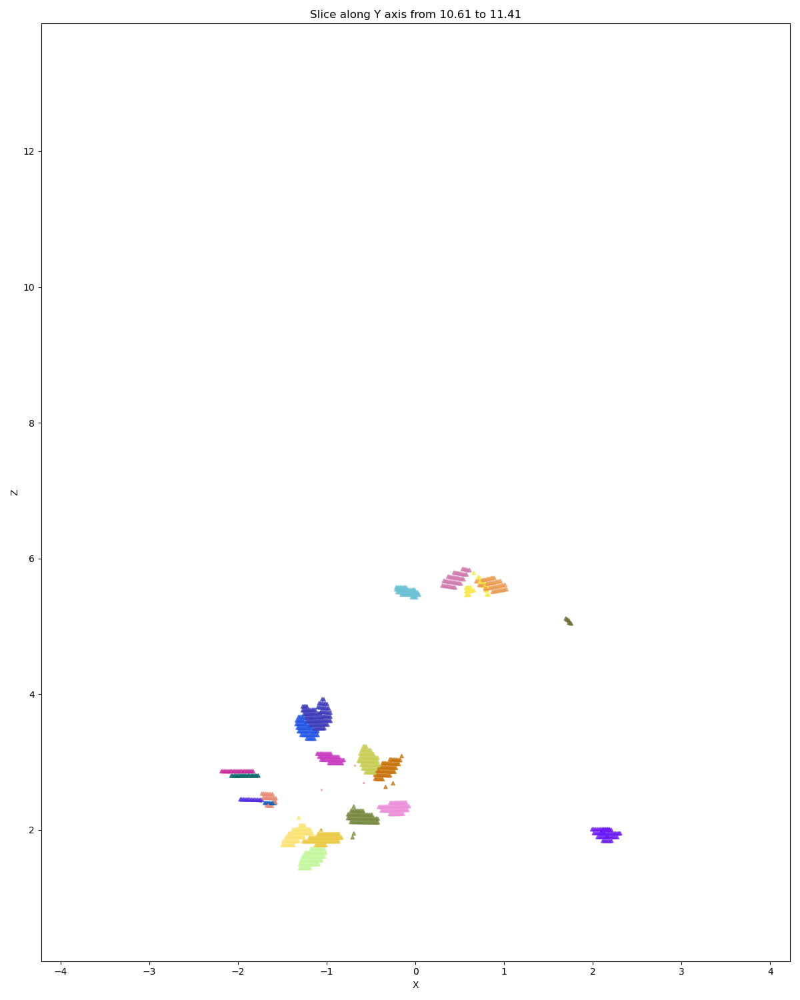

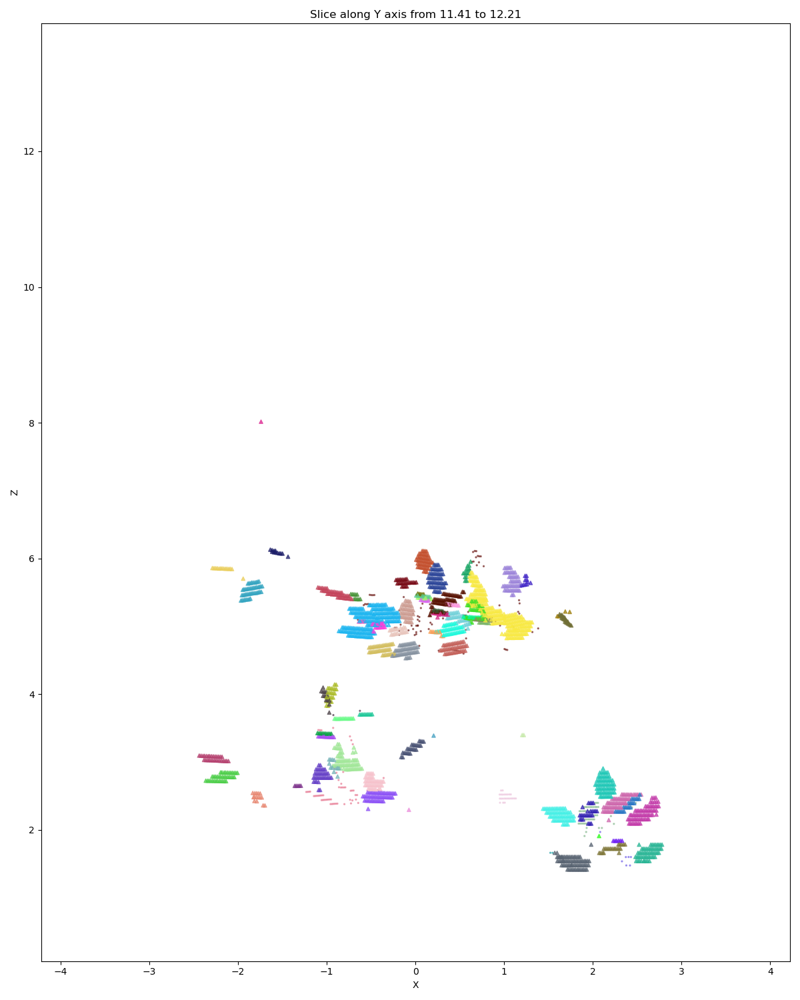

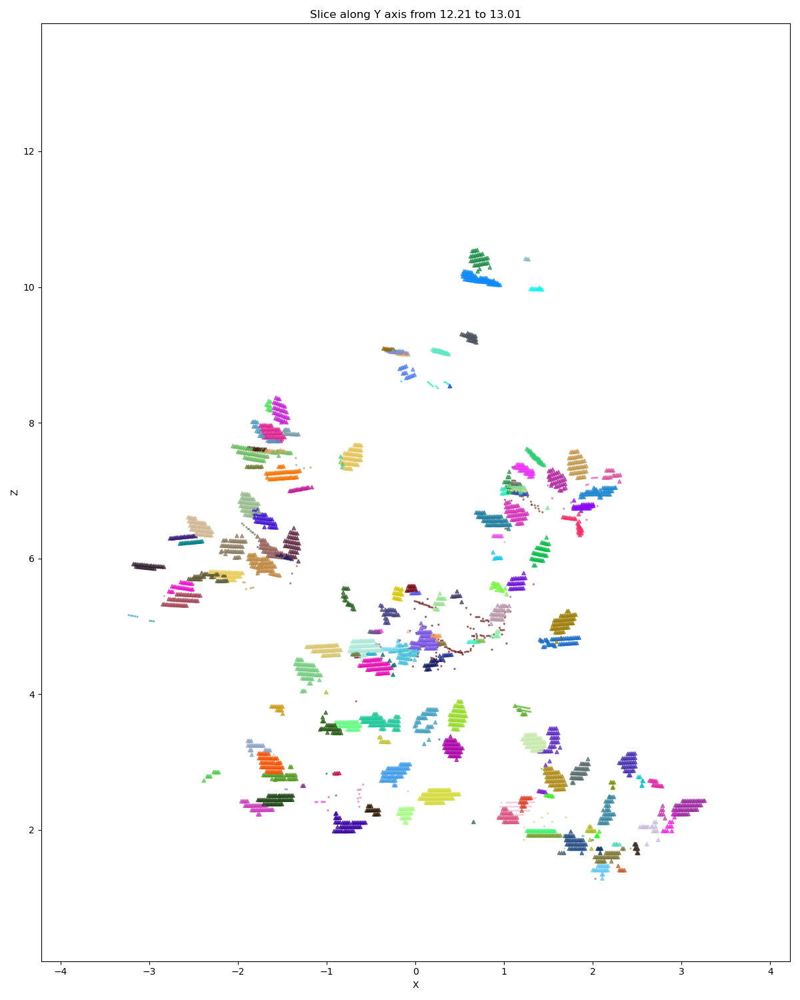

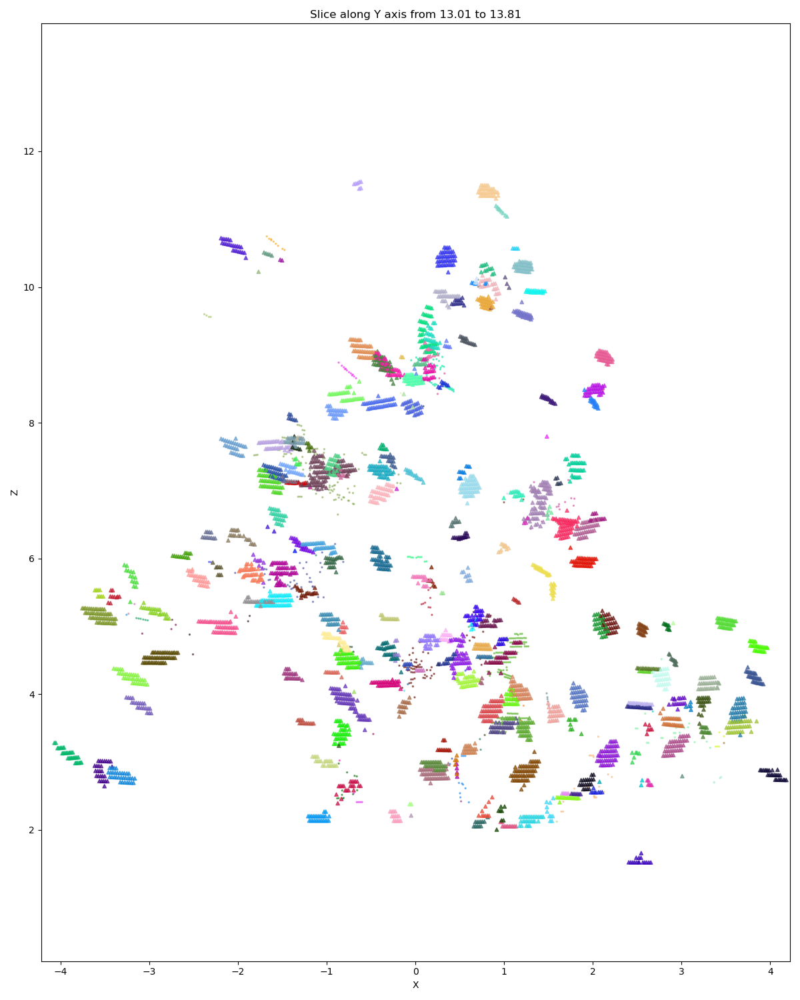

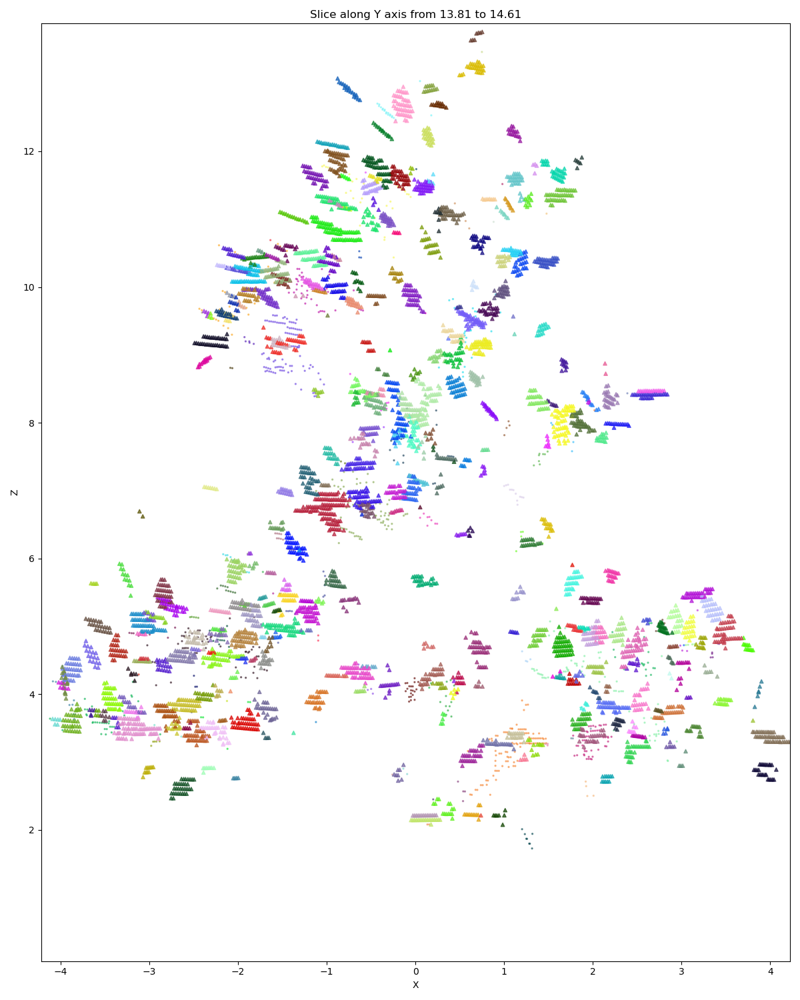

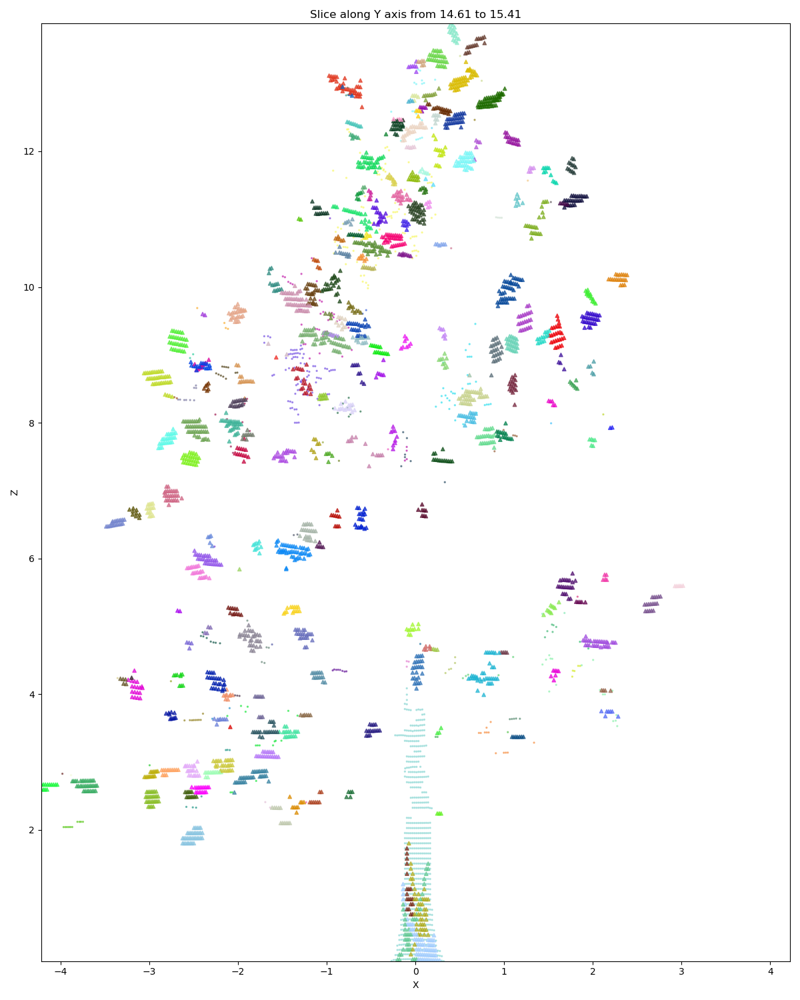

In [34]:
# slices along y axis
y_min = np.min(orig_points[:,1])
y_max = np.max(orig_points[:,1])
slice_thickness = 0.4 / 0.5  # original thickness before scaling
y = y_min
while y < y_max:
    slice_points = orig_points[(orig_points[:,1] >= y) & (orig_points[:,1] < y + slice_thickness)]
    slice_labels = new_labels[(orig_points[:,1] >= y) & (orig_points[:,1] < y + slice_thickness)]
    slice_is_leaf = is_leaf_label[(orig_points[:,1] >= y) & (orig_points[:,1] < y + slice_thickness)]
    
    # plot the slice with cluster colors
    fig = plt.figure(figsize=(12,15))
    ax = fig.add_subplot(111)
    valid_indices = slice_labels != -1
    slice_points_plot = slice_points[valid_indices]
    slice_labels_plot = slice_labels[valid_indices]
    colors_plot = np.array([label_to_color[label] for label in slice_labels_plot])
    # plot leaf points as triangles    
    leaf_indices = slice_is_leaf[valid_indices]
    non_leaf_indices = ~leaf_indices
    ax.scatter(slice_points_plot[non_leaf_indices,0], slice_points_plot[non_leaf_indices,2], c=colors_plot[non_leaf_indices], s=2, alpha=0.5)
    ax.scatter(slice_points_plot[leaf_indices,0], slice_points_plot[leaf_indices,2], c=colors_plot[leaf_indices], s=15, marker='^', alpha=0.7)
    ax.set_xlabel('X')
    ax.set_ylabel('Z')
    # ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(np.min(orig_points[:,0]), np.max(orig_points[:,0]))
    ax.set_ylim(np.min(orig_points[:,2]), np.max(orig_points[:,2]))
    ax.set_title(f'Slice along Y axis from {y:.2f} to {y + slice_thickness:.2f}')
    plt.tight_layout()
    plt.show()
    
    y += slice_thickness

In [ ]:
# def cluster_is_leaf_like(cluster_points, min_points=15, max_points=80, min_ratio=20):
#     linearity, planarity, sphericity = analyze_cluster_shape(cluster_points)
#     ratio = planarity / (sphericity + 1e-7)
#     print(f"Cluster size: {cluster_points.shape[0]}, Linearity: {linearity:.4f}, Planarity: {planarity:.4f}, Sphericity: {sphericity:.4f}, Ratio: {ratio:.4f}")
#     if cluster_points.shape[0] >= min_points and cluster_points.shape[0] <= max_points and ratio >= min_ratio and planarity > 0.09:
#         return True, linearity, planarity, sphericity
#     return False, linearity, planarity, sphericity

In [ ]:

# # inspecting the non-leaf clusters
# # loop through all unique new_labels, and plot the clusters that are not leaf-like
# for label in unique_labels:
#     # loop through all unique new_labels, and plot the clusters that are not leaf-like
#     if label == -1:
#         continue  # skip noise
#     cluster_points = orig_points[new_labels == label]
#     cluster_is_leaf = is_leaf_label[new_labels == label]
#     if np.any(cluster_is_leaf):
#         continue  # skip leaf-like clusters
    
#     if cluster_points.shape[0] < 20:
#         continue  # skip small clusters
    
#     # toss a coin to decide whether to plot this cluster
#     if np.random.rand() > 0.1:
#         continue
    
#     # try RANSAC to see if we can find leaf planes
#     leaf_planes = find_leaf_planes_ransac(cluster_points, distance_threshold=0.02)
#     # print(leaf_planes)
    
#     is_leaf_planes = []
#     for i, plane in enumerate(leaf_planes):
#         # check if this plane is leaf-like
#         is_leaf, linearity, planarity, sphericity = cluster_is_leaf_like(plane, min_points=15, max_points=80, min_ratio=20)
#         is_leaf_planes.append(is_leaf)
    
#     # is_leaf, linearity, planarity, sphericity = cluster_is_leaf_like(cluster_points, min_points=15, max_points=80, min_ratio=20)
#     # print(f"Cluster {label} - Is leaf-like: {is_leaf}, Linearity: {linearity:.4f}, Planarity: {planarity:.4f}, Sphericity: {sphericity:.4f}")
    
#     print(f"Plotting non-leaf cluster {label} with {cluster_points.shape[0]} points")
#     fig = plt.figure(figsize=(10,10))
#     ax = fig.add_subplot(111, projection='3d')  
#     sc = ax.scatter(cluster_points[:,0], cluster_points[:,1], cluster_points[:,2], c='b', s=10)
#     # plot leaf planes found by RANSAC
#     for i, plane in enumerate(leaf_planes):
#         if is_leaf_planes[i]:
#             ax.scatter(plane[:,0], plane[:,1], plane[:,2], c='r', s=20, marker='^')
#     ax.set_xlabel('X')
#     ax.set_ylabel('Y')
#     ax.set_zlabel('Z')
#     plt.tight_layout()
#     plt.show()


# Compute leaf area

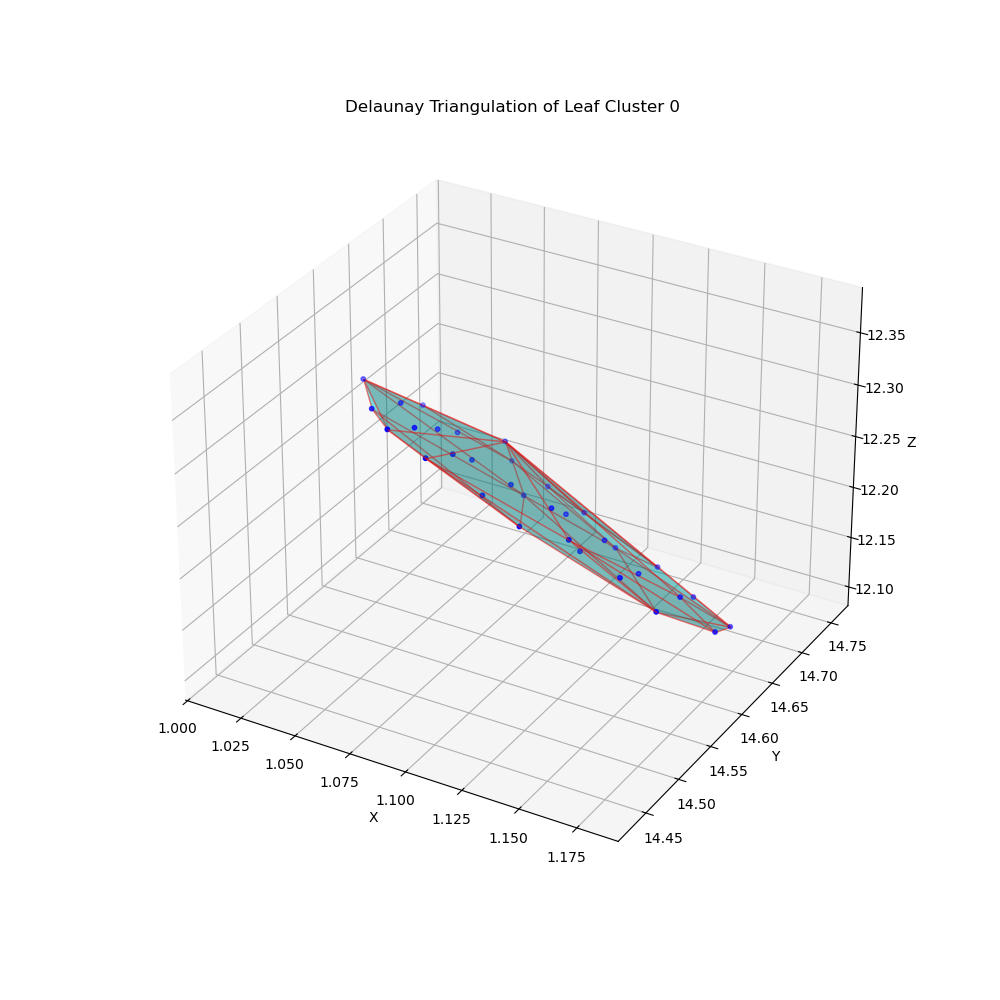

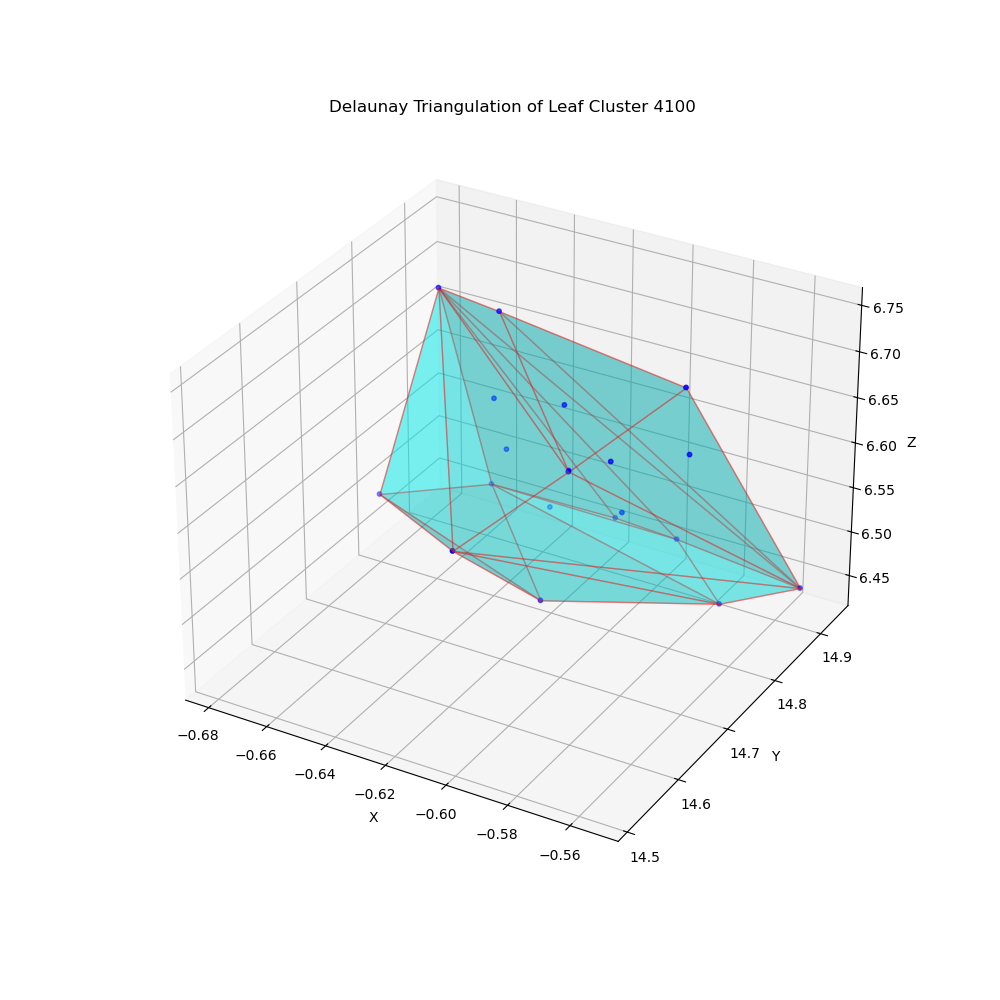

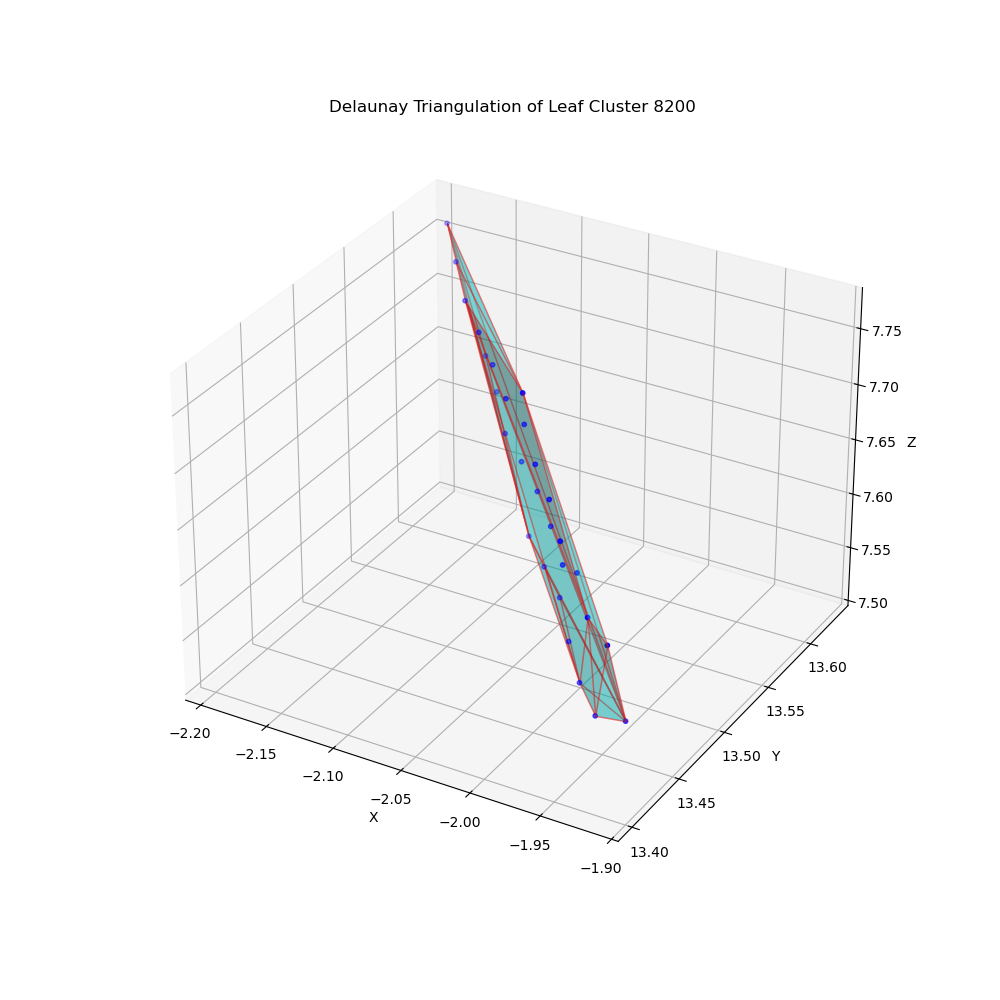

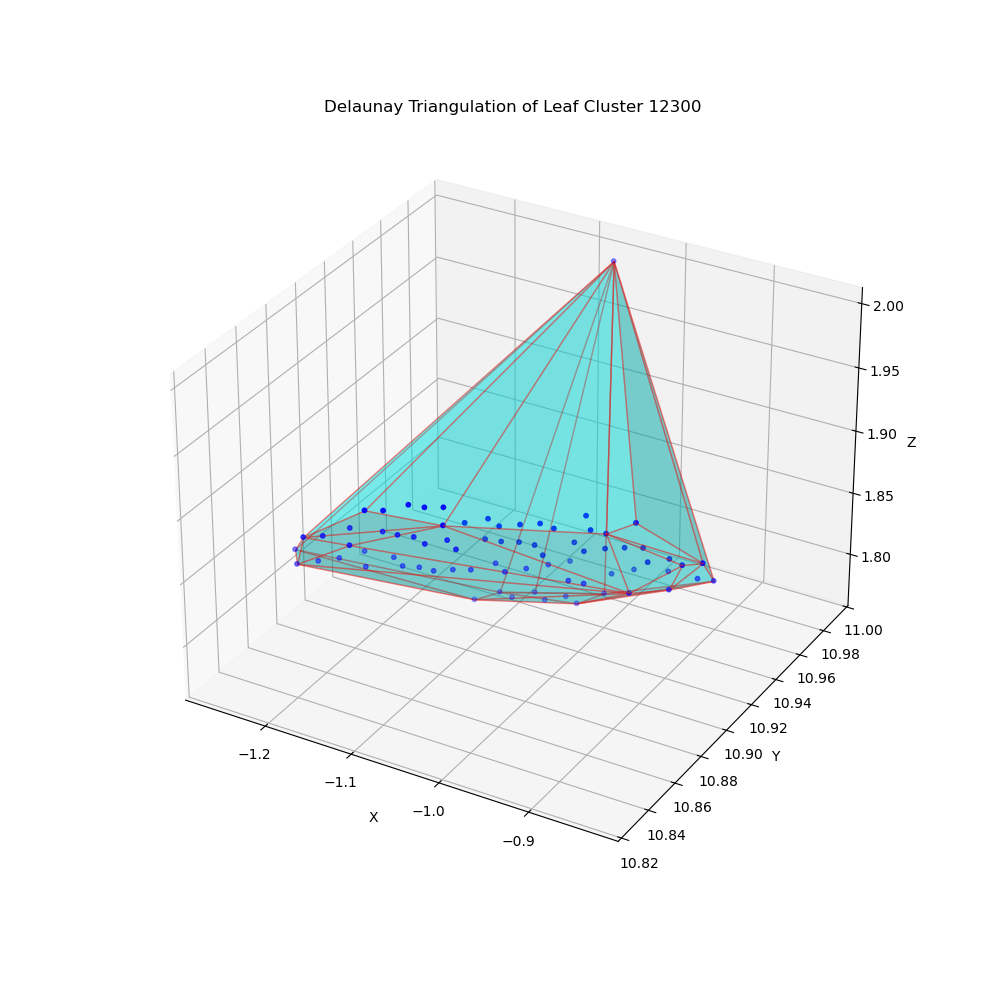

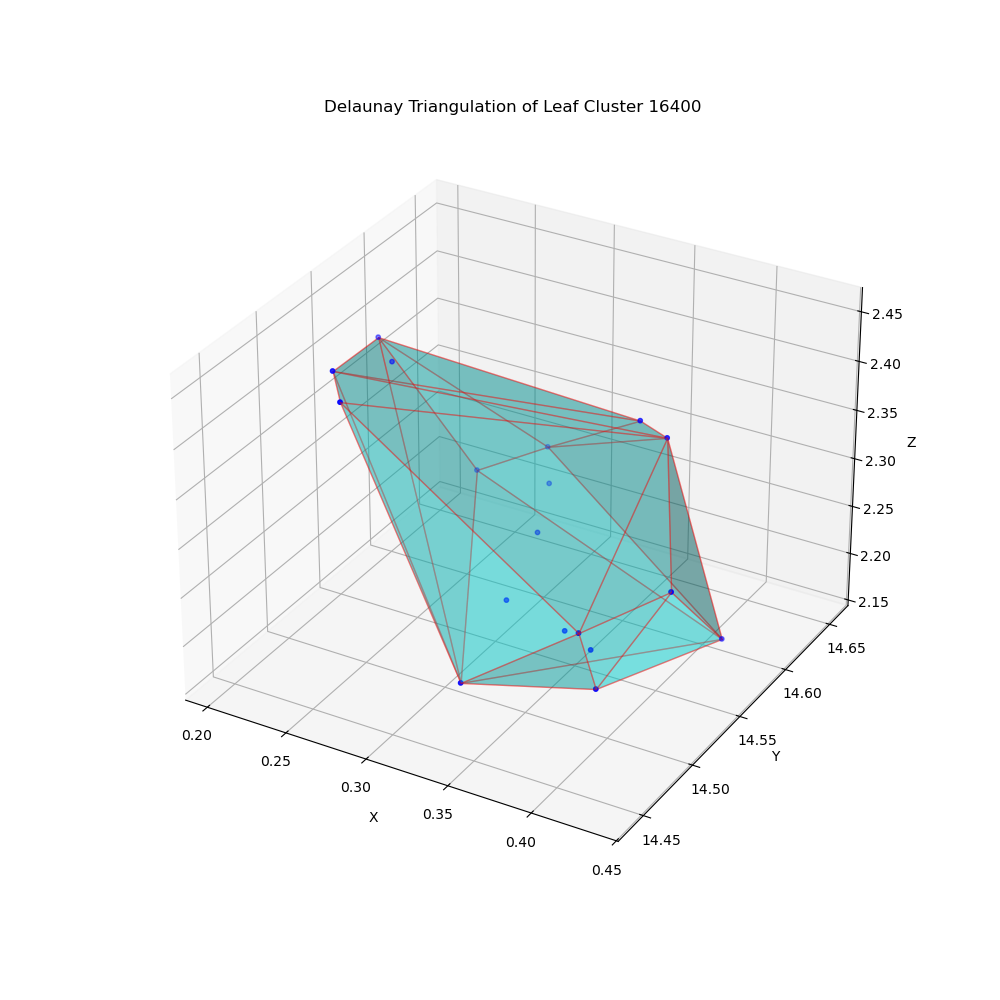

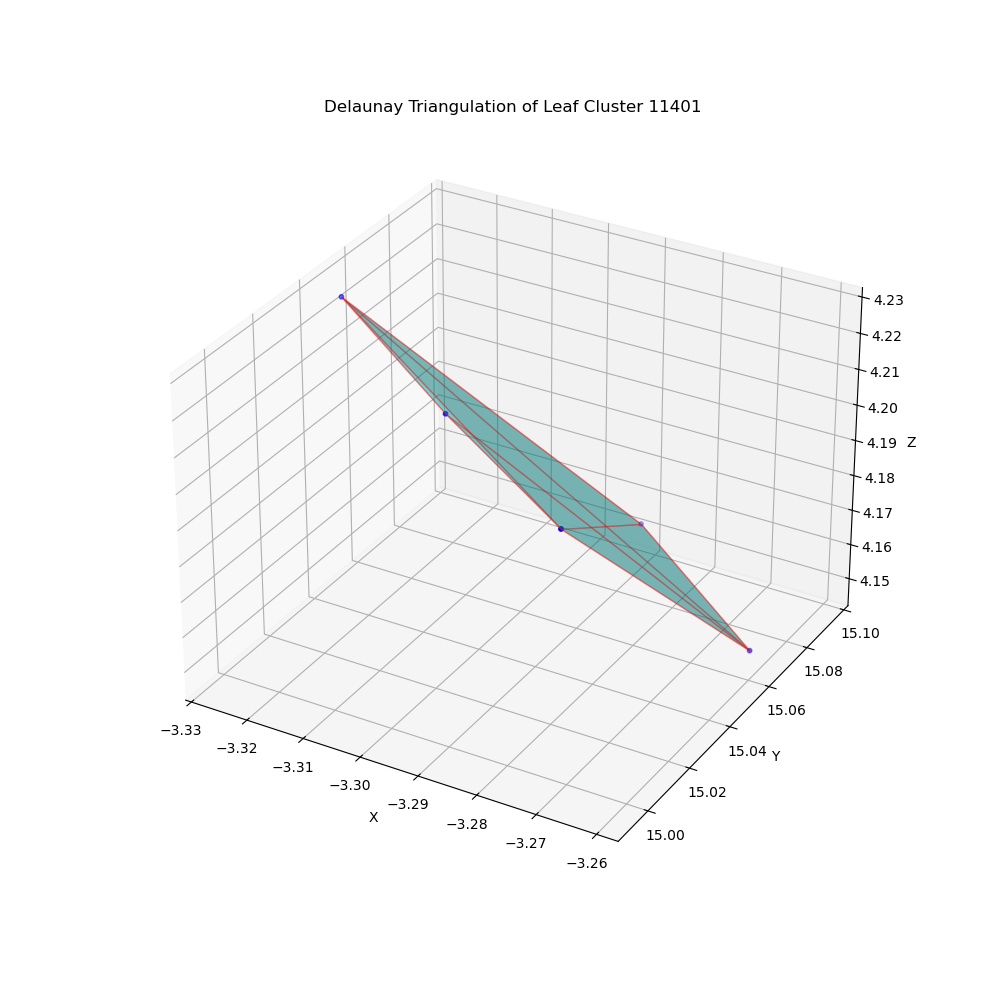

Cluster 7812 cannot find convex hull.
Cluster 2717 cannot find convex hull.
Cluster 1024 cannot find convex hull.
Cluster 4017 cannot find convex hull.
Cluster 4016 cannot find convex hull.


In [35]:
# for each leaf cluster, divide it to to triangles using Delaunay triangulation and compute area by summing triangle areas
from scipy.spatial import ConvexHull
leaf_areas = []
cluster_label_2_area = {}
count = 0
for cluster_label in set(new_labels):
    points = orig_points[new_labels == cluster_label]
    is_leaf = is_leaf_label[new_labels == cluster_label]
    if not np.all(is_leaf):
        continue  # not a leaf cluster
    
    # compute delaunay triangulation in 3D
    try:
        hull = ConvexHull(points)
    except:
        print(f"Cluster {cluster_label} cannot find convex hull.")
        continue  # skip clusters that cannot be triangulated
    
    # plot triangulation
    if count <= 5:
        fig = plt.figure(figsize=(10,10))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(points[:,0], points[:,1], points[:,2], s=10, color='b')
        for simplex in hull.simplices:
            tri_points = points[simplex]
            ax.plot_trisurf(tri_points[:,0], tri_points[:,1], tri_points[:,2], color='cyan', alpha=0.3, edgecolor='r')
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        plt.title(f'Delaunay Triangulation of Leaf Cluster {cluster_label}')
        plt.show()
    count += 1
    
    # compute area of each triangle
    area = hull.area / 2.0  # Leaft area is half of the convex hull area
    leaf_areas.append(area)
    cluster_label_2_area[cluster_label] = area

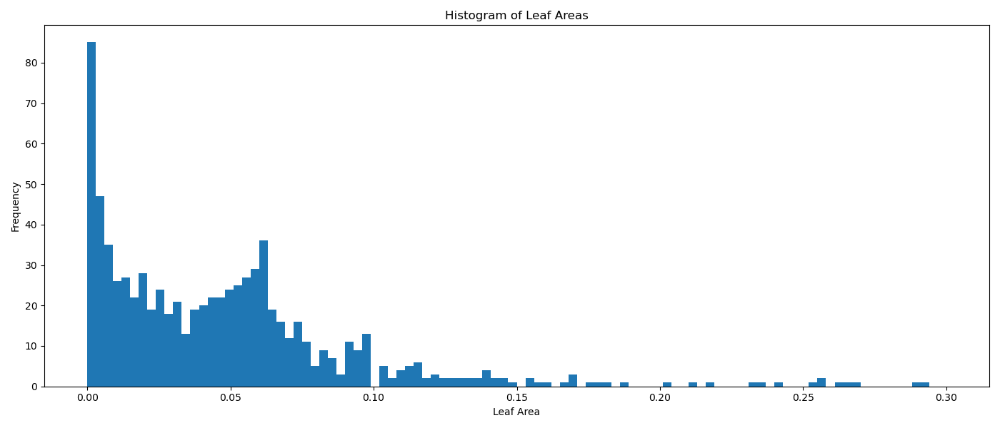

In [36]:
# plot histogram of leaf areas
plt.figure(figsize=(14,6))
plt.hist(leaf_areas, bins=100, range=(0, 0.3))
plt.xlabel('Leaf Area')
plt.ylabel('Frequency')
plt.title('Histogram of Leaf Areas')
plt.tight_layout()
plt.show()  

The leaves which have area above 0.15 m^2 are very suspicious, so we calculate the total leaf area excluding those leaves.

In [47]:
# total leaf area
leaf_area_threshold = 0.30 # We accept case where there is 2 leaves merged together
leaf_lower_bound = 0.02
leaf_areas = np.array(leaf_areas)
total_leaf_area = np.sum(leaf_areas[(leaf_areas < leaf_area_threshold) & (leaf_areas > leaf_lower_bound)])
print(f"Estimated total leaf area (excluding leaves with area > {leaf_area_threshold} m^2): {total_leaf_area * 2:.2f} m^2")
print(f"Estimated number of leaves: {len(leaf_areas[(leaf_areas < leaf_area_threshold) & (leaf_areas > leaf_lower_bound)])*2}")

Estimated total leaf area (excluding leaves with area > 0.3 m^2): 71.15 m^2
Estimated number of leaves: 1054


In [48]:
leaf_areas_column = []
for label in new_labels:
    if label in cluster_label_2_area:
        leaf_areas_column.append(cluster_label_2_area[label])
    else:
        leaf_areas_column.append(0.0)
leaf_areas_column = np.array(leaf_areas_column)

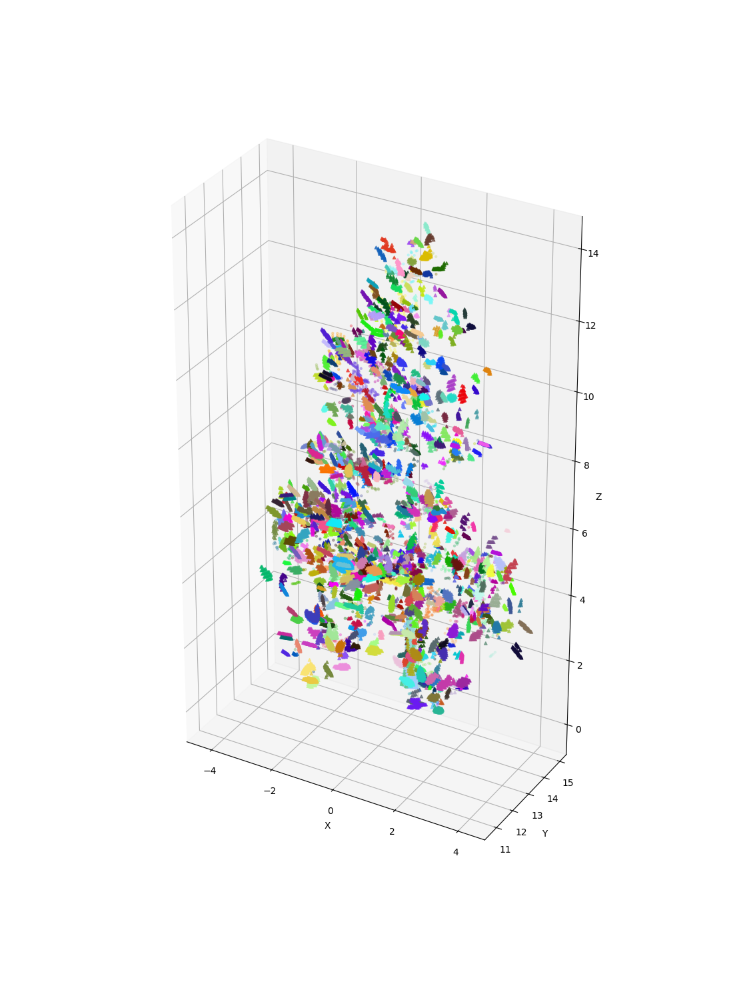

In [49]:
# re plot the tree, remove is_leaf points which have area > 0.2 m^2

# plot tree using new labels
fig = plt.figure(figsize=(11,15))
ax = fig.add_subplot(111, projection='3d')  
# remove points which belong to no cluster (label = -1)
valid_indices = new_labels != -1
sampled_points_plot = orig_points[valid_indices]
labels_plot = new_labels[valid_indices] 
colors_plot = np.array([label_to_color[label] for label in labels_plot])
# plot leaf points as triangles
leaf_indices = is_leaf_label[valid_indices] & (leaf_areas_column[valid_indices] < leaf_area_threshold)
non_leaf_indices = ~leaf_indices
ax.scatter(sampled_points_plot[non_leaf_indices,0], sampled_points_plot[non_leaf_indices,1], sampled_points_plot[non_leaf_indices,2], c=colors_plot[non_leaf_indices], s=5, alpha=0.3)
ax.scatter(sampled_points_plot[leaf_indices,0], sampled_points_plot[leaf_indices,1], sampled_points_plot[leaf_indices,2], c=colors_plot[leaf_indices], s=10, marker='^', alpha=0.7)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_box_aspect([4, 2, 7])  # different aspect ratio
plt.tight_layout()

plt.show()

## CT scan along z-axis, excluding spuriously large leaves

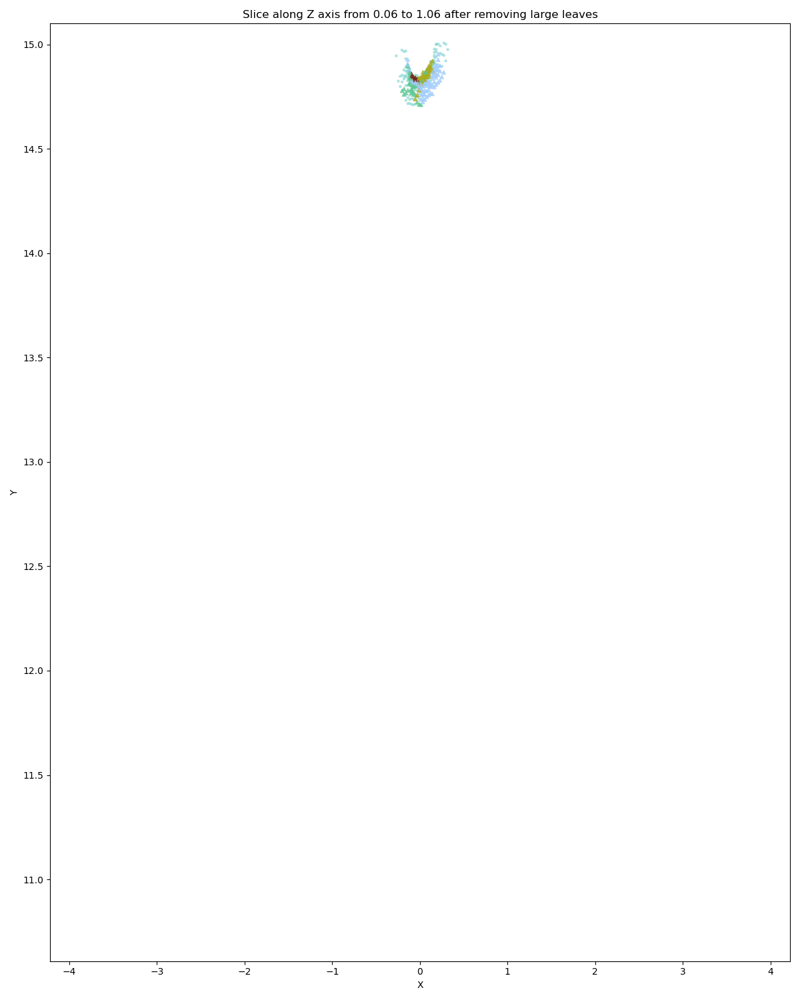

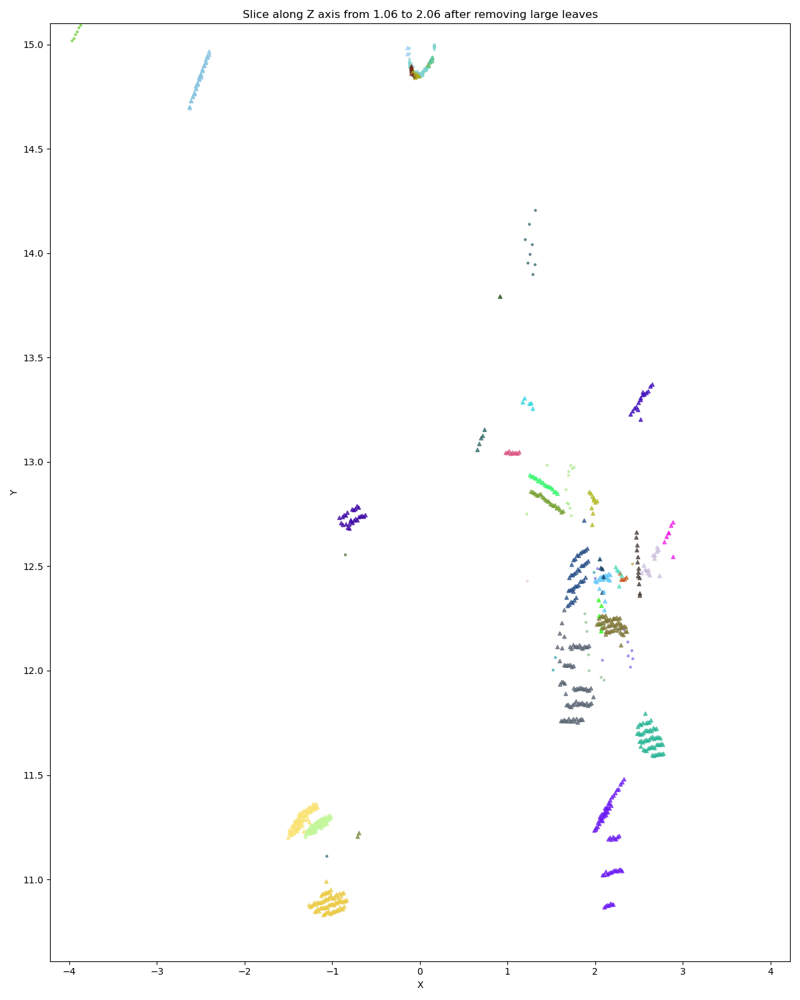

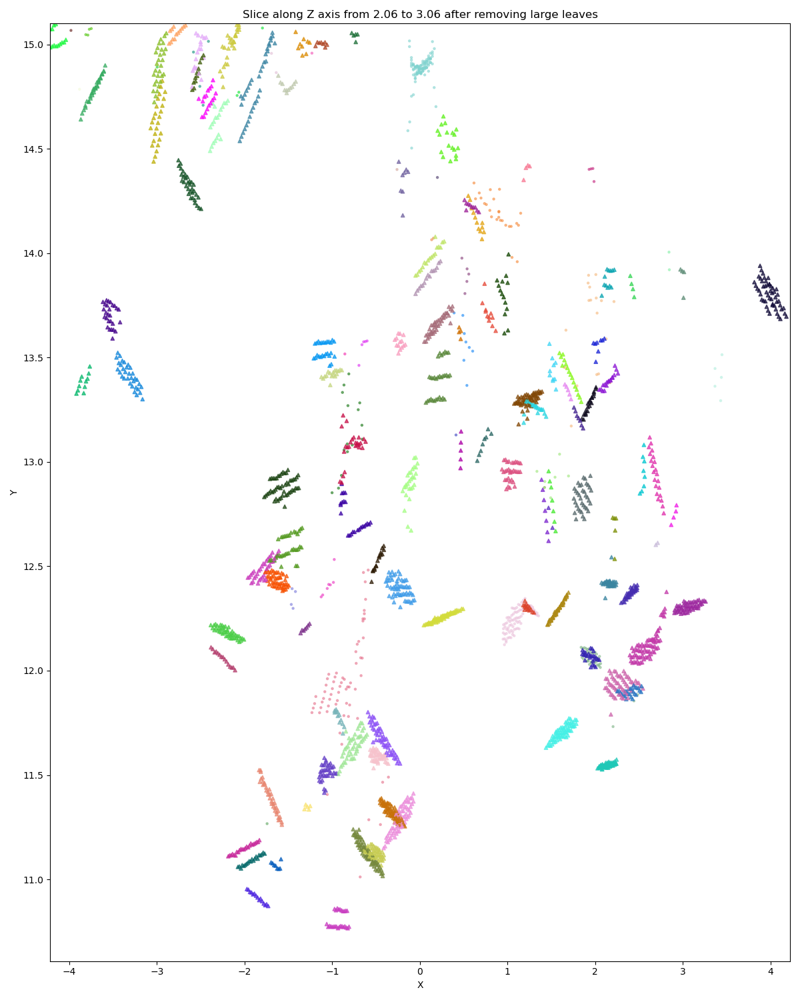

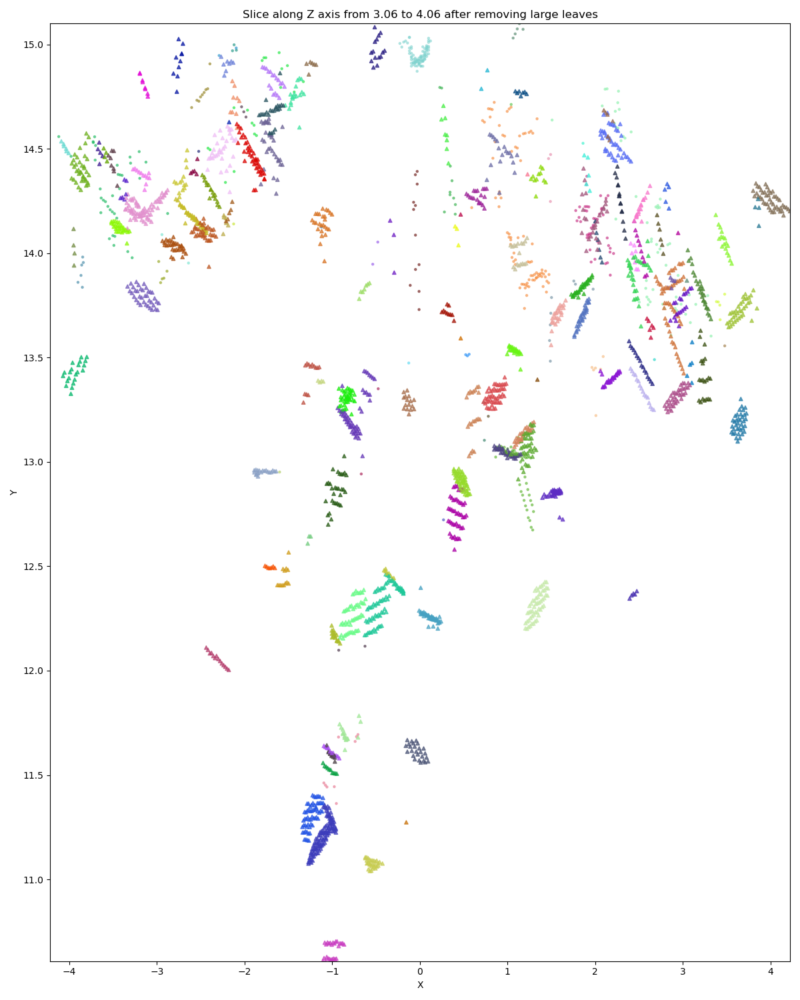

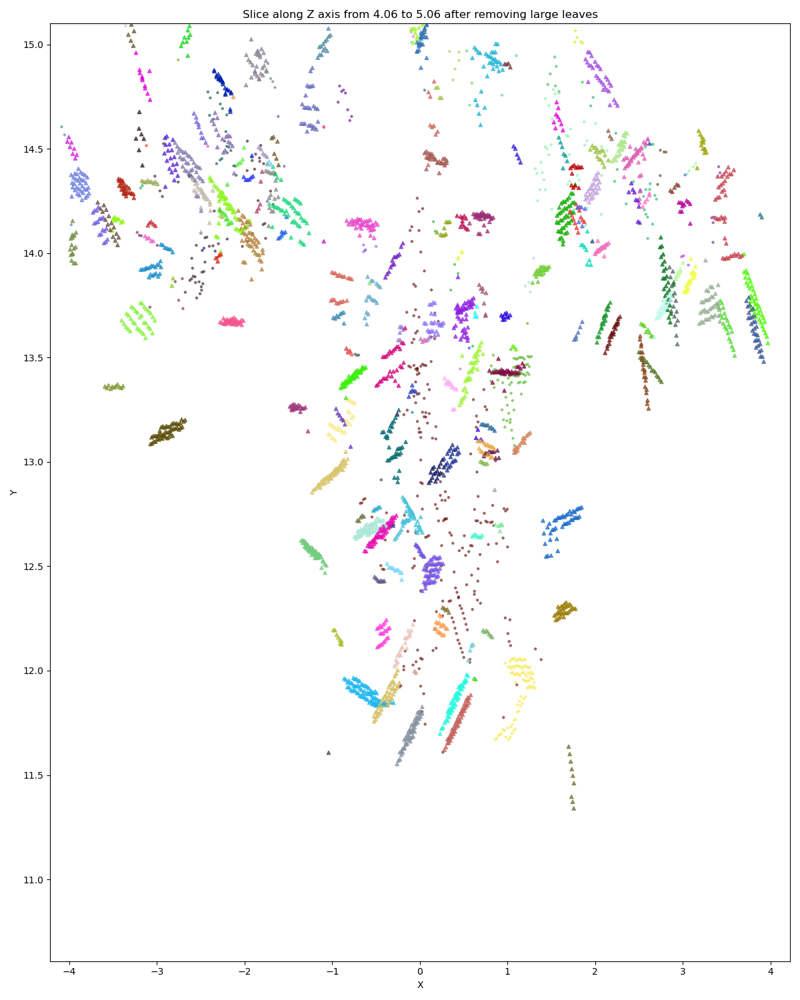

...

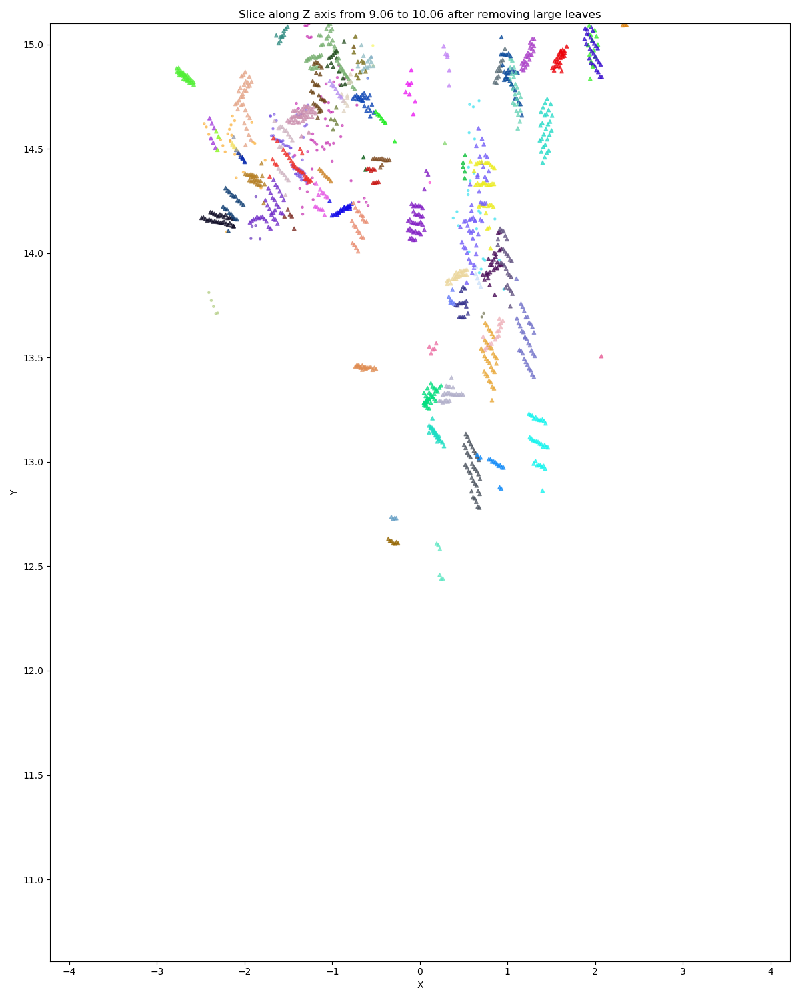

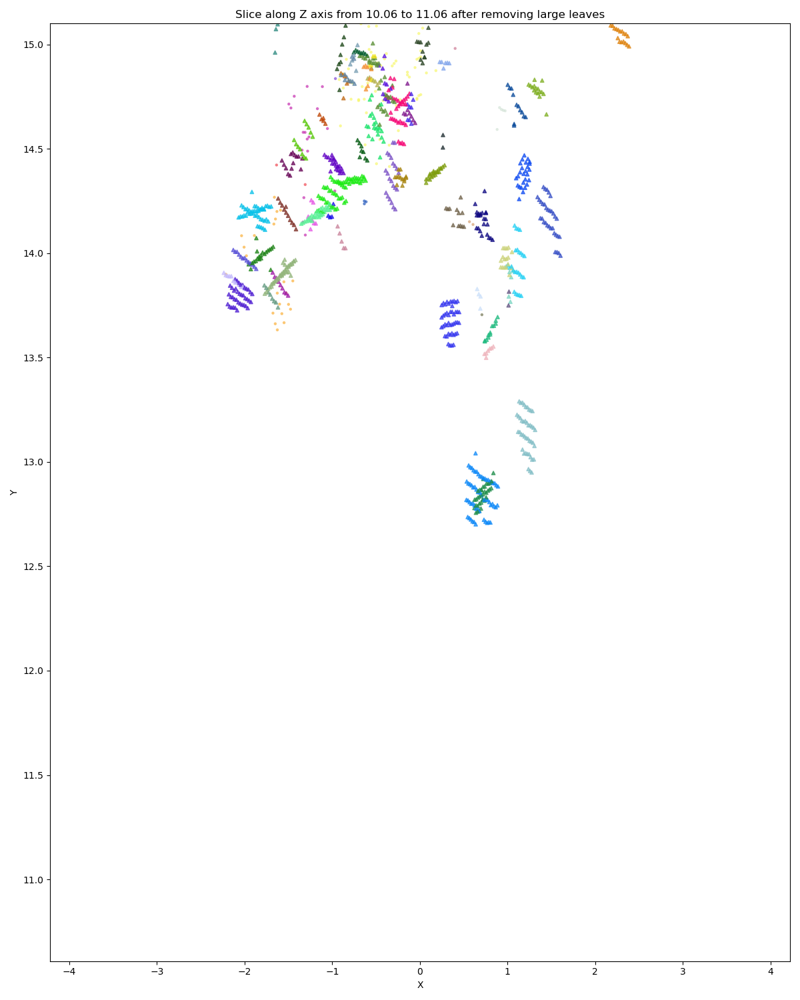

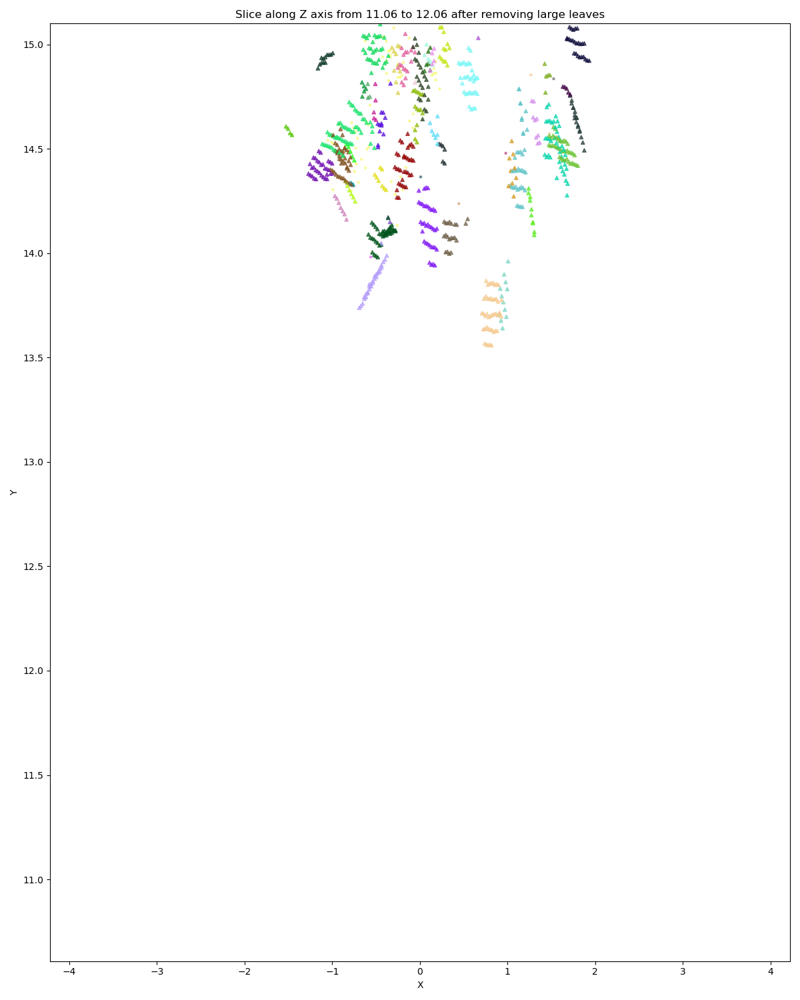

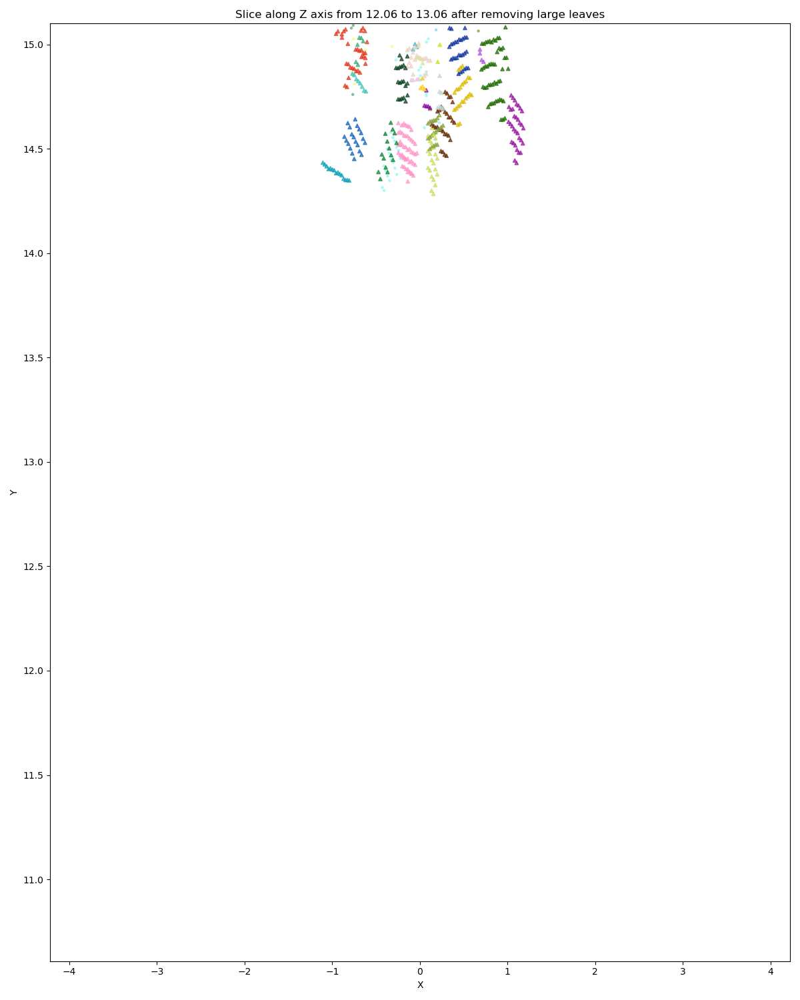

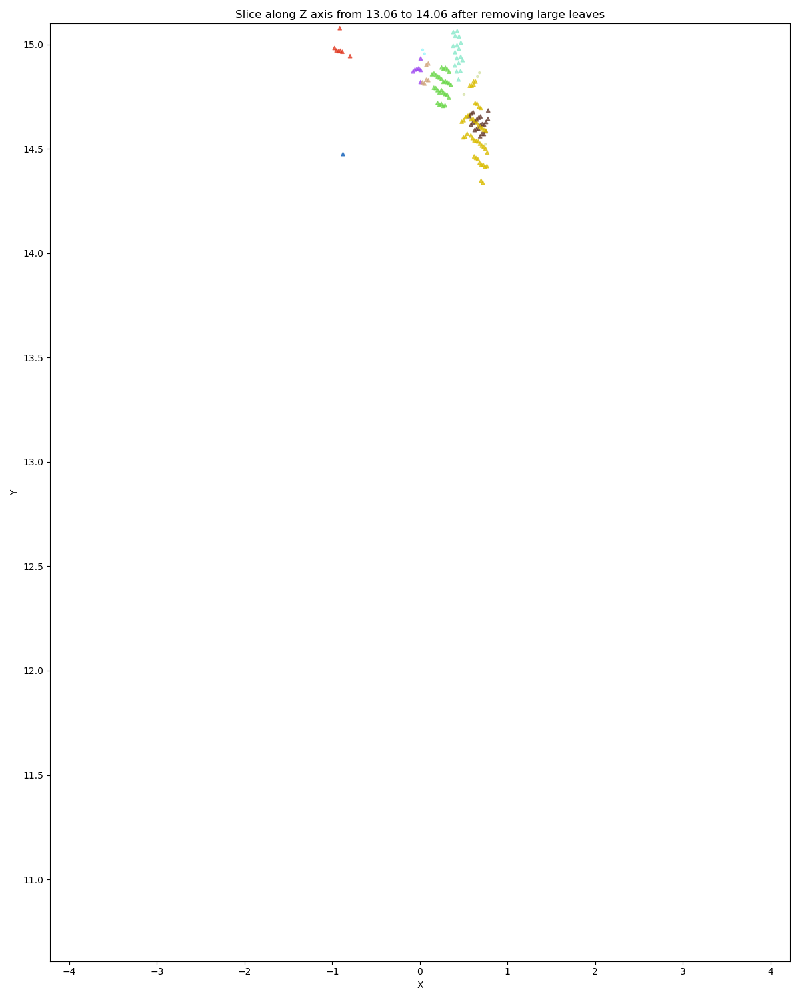

In [50]:
# plot ct scan along Z axis after removing large leaves
z_min = np.min(orig_points[:,2])
z_max = np.max(orig_points[:,2])
slice_thickness = 0.30 / 0.3  # original thickness before scaling
z = z_min
while z < z_max:
    slice_points = orig_points[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    slice_labels = new_labels[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    slice_is_leaf = is_leaf_label[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    slice_leaf_areas = leaf_areas_column[(orig_points[:,2] >= z) & (orig_points[:,2] < z + slice_thickness)]
    
    # plot the slice with cluster colors
    fig = plt.figure(figsize=(12,15))
    ax = fig.add_subplot(111)
    valid_indices = slice_labels != -1
    slice_points_plot = slice_points[valid_indices]
    slice_labels_plot = slice_labels[valid_indices]
    
    # remove leaf points with area > threshold
    leaf_indices = slice_is_leaf[valid_indices] & (slice_leaf_areas[valid_indices] < leaf_area_threshold)
    non_leaf_indices = ~leaf_indices
    
    colors_plot = np.array([label_to_color[label] for label in slice_labels_plot])
    # plot leaf points as triangles    
    ax.scatter(slice_points_plot[non_leaf_indices,0], slice_points_plot[non_leaf_indices,1], c=colors_plot[non_leaf_indices], s=5, alpha=0.5)
    ax.scatter(slice_points_plot[leaf_indices,0], slice_points_plot[leaf_indices,1], c=colors_plot[leaf_indices], s=15, marker='^', alpha=0.7)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    # ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(np.min(orig_points[:,0]), np.max(orig_points[:,0]))
    ax.set_ylim(np.min(orig_points[:,1]), np.max(orig_points[:,1]))
    ax.set_title(f'Slice along Z axis from {z:.2f} to {z + slice_thickness:.2f} after removing large leaves')
    plt.tight_layout()
    plt.show()
    
    z += slice_thickness

## CT scan along y-axis, excluding spuriously large leaves

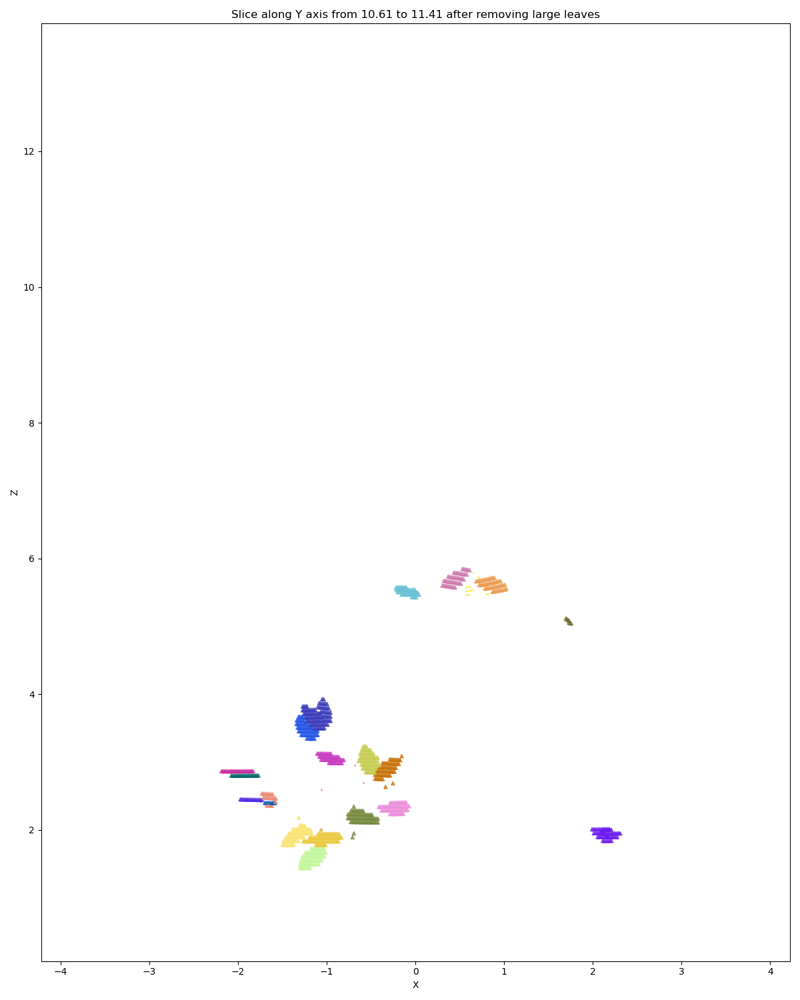

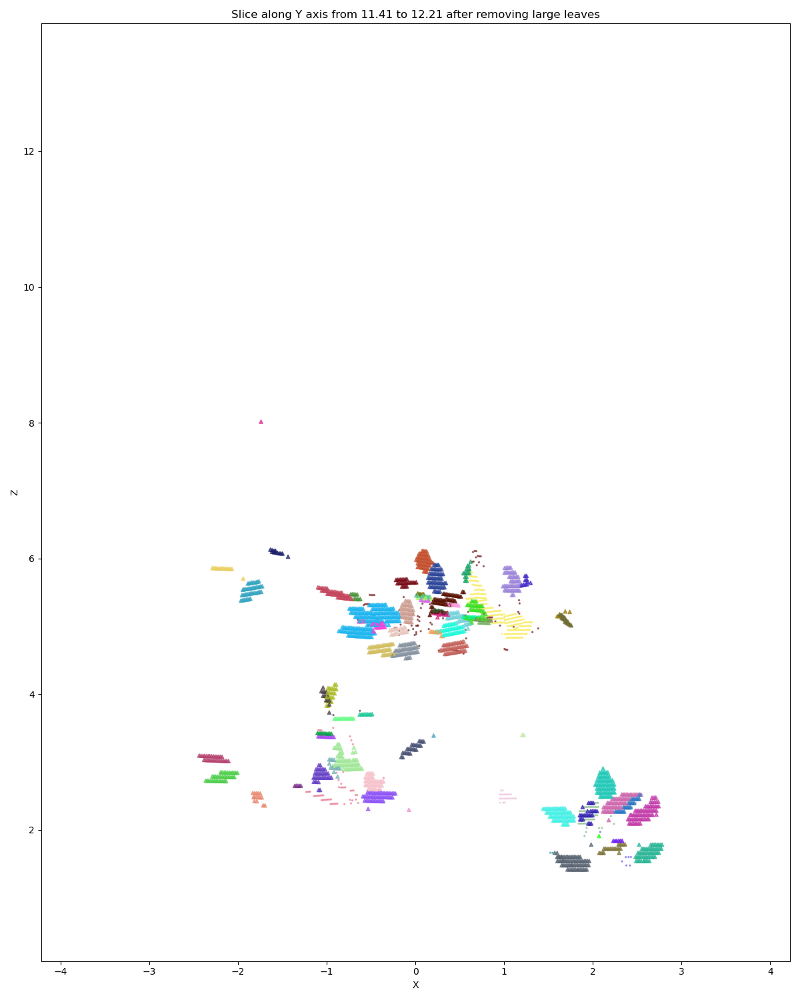

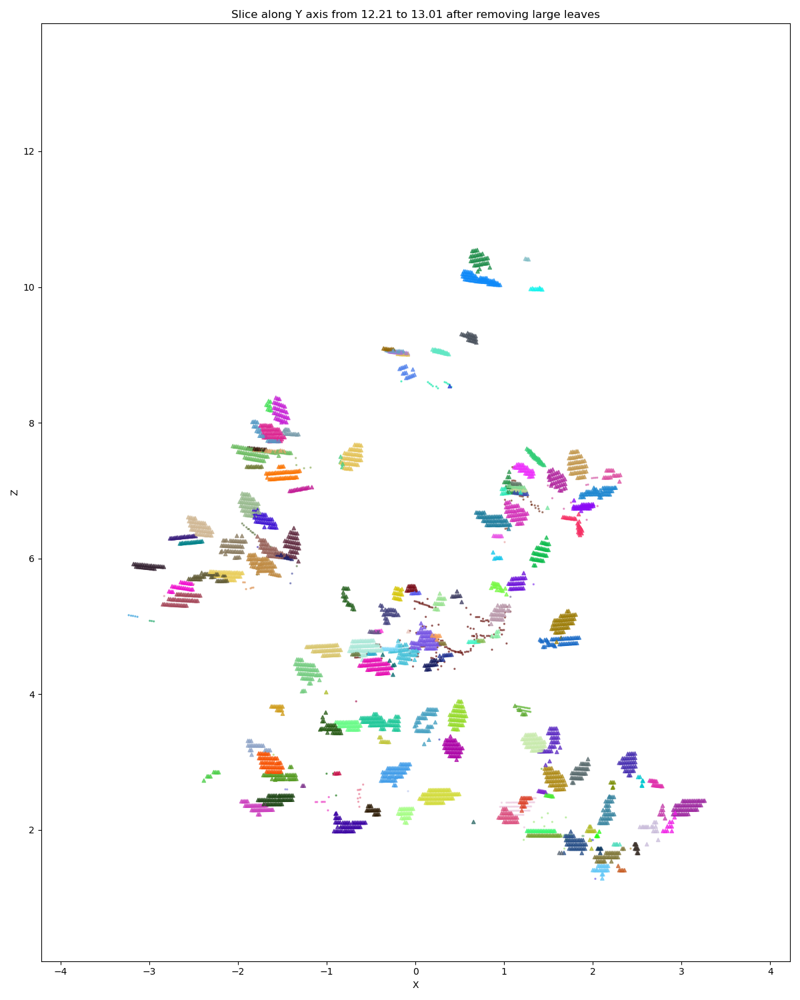

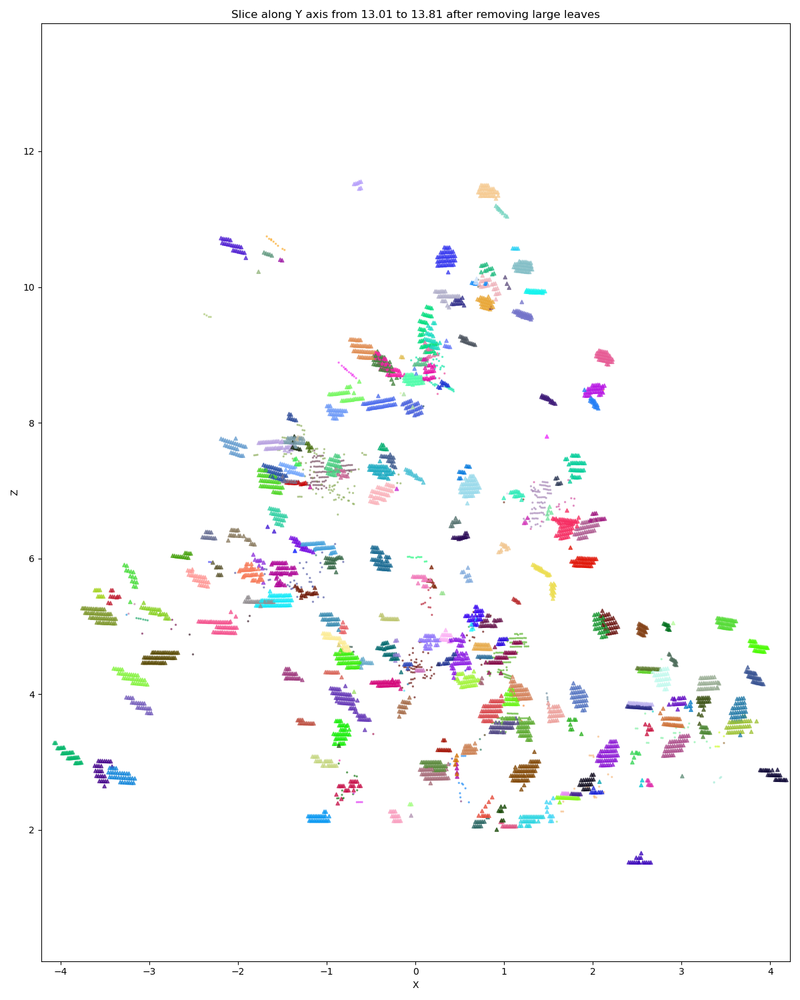

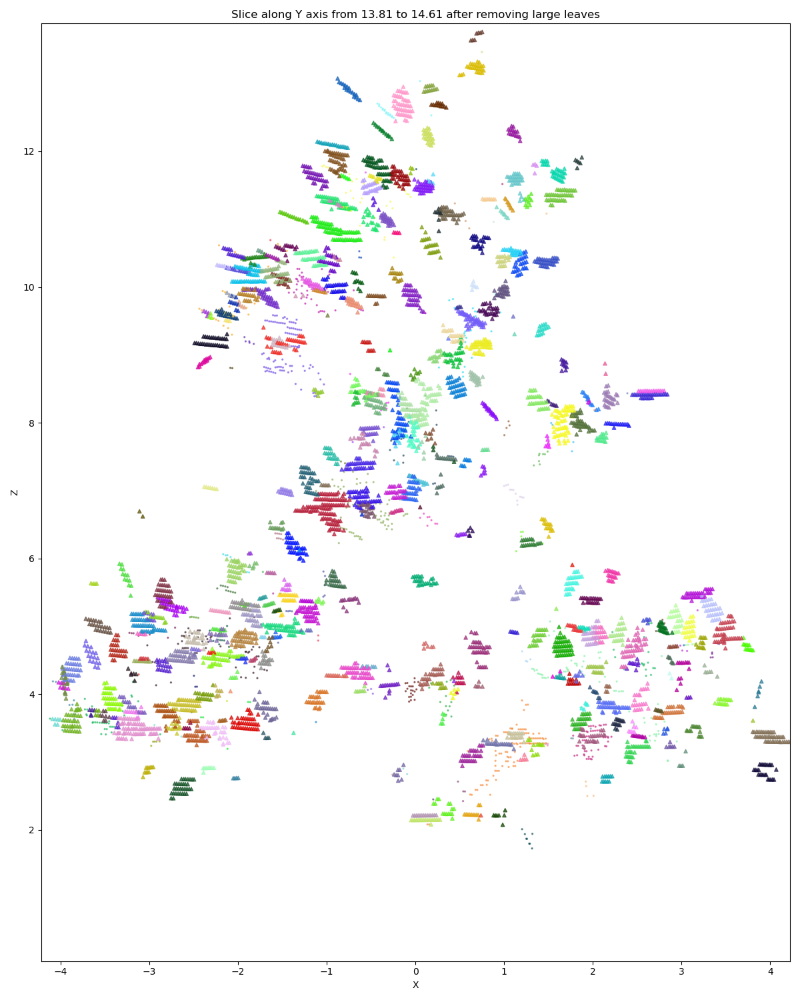

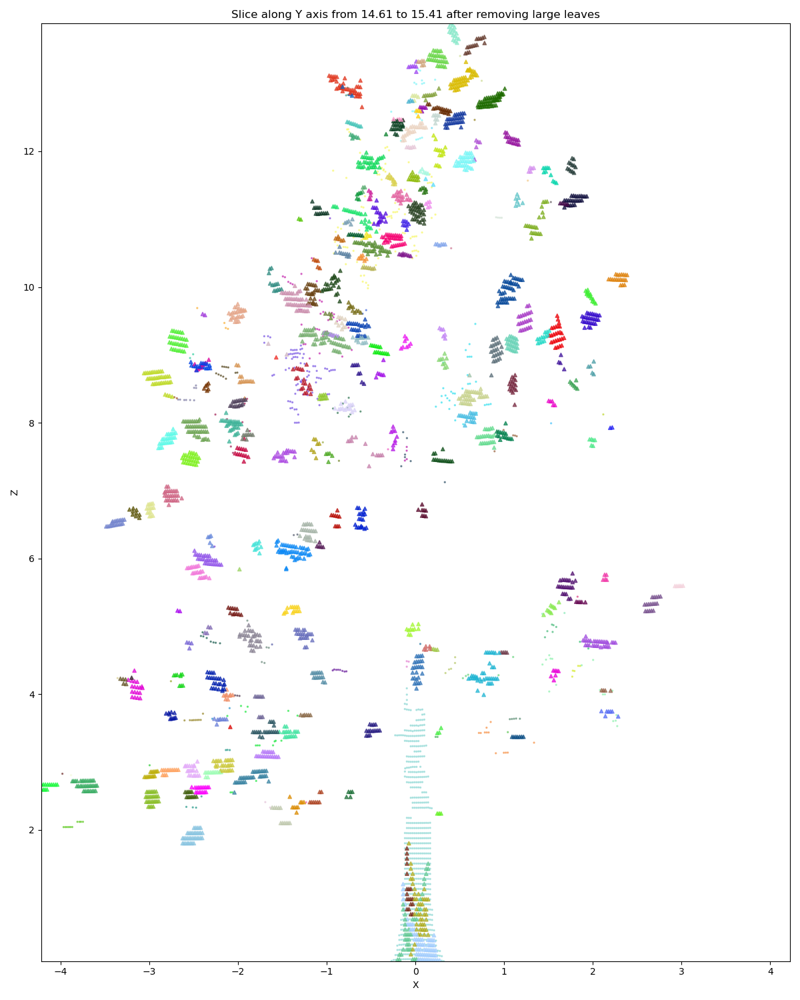

In [51]:
# ct scan along y axis after removing large leaves
y_min = np.min(orig_points[:,1])
y_max = np.max(orig_points[:,1])
slice_thickness = 0.4 / 0.5  # original thickness before scaling
y = y_min
while y < y_max:
    slice_points = orig_points[(orig_points[:,1] >= y) & (orig_points[:,1] < y + slice_thickness)]
    slice_labels = new_labels[(orig_points[:,1] >= y) & (orig_points[:,1] < y + slice_thickness)]
    slice_is_leaf = is_leaf_label[(orig_points[:,1] >= y) & (orig_points[:,1] < y + slice_thickness)]
    slice_leaf_areas = leaf_areas_column[(orig_points[:,1] >= y) & (orig_points[:,1] < y + slice_thickness)]
    
    # plot the slice with cluster colors
    fig = plt.figure(figsize=(12,15))
    ax = fig.add_subplot(111)
    valid_indices = slice_labels != -1
    slice_points_plot = slice_points[valid_indices]
    slice_labels_plot = slice_labels[valid_indices]
    
    # remove leaf points with area > threshold
    leaf_indices = slice_is_leaf[valid_indices] & (slice_leaf_areas[valid_indices] < leaf_area_threshold)
    non_leaf_indices = ~leaf_indices
    
    colors_plot = np.array([label_to_color[label] for label in slice_labels_plot])
    # plot leaf points as triangles    
    ax.scatter(slice_points_plot[non_leaf_indices,0], slice_points_plot[non_leaf_indices,2], c=colors_plot[non_leaf_indices], s=2, alpha=0.5)
    ax.scatter(slice_points_plot[leaf_indices,0], slice_points_plot[leaf_indices,2], c=colors_plot[leaf_indices], s=15, marker='^', alpha=0.7)
    ax.set_xlabel('X')
    ax.set_ylabel('Z')
    # ax.set_aspect('equal', adjustable='box')
    ax.set_xlim(np.min(orig_points[:,0]), np.max(orig_points[:,0]))
    ax.set_ylim(np.min(orig_points[:,2]), np.max(orig_points[:,2]))
    ax.set_title(f'Slice along Y axis from {y:.2f} to {y + slice_thickness:.2f} after removing large leaves')
    plt.tight_layout()
    plt.show()
    
    y += slice_thickness

# Summary
- We proposed a method to identify leaves from a tree point cloud obtained by a terrestrial LiDAR scanner.
- The method go through several steps:
    1. Keep only the tree half which faces the LiDAR scanner.
    2. Cluster the tree into smaller clusters.
    3. For each smaller cluster, find the best clustering which gives the most leaf-like clusters. The clustering proposing methods are: **DBSCAN with different scaling of y-axis and z-axis**; **RANSAC** plane fitting. The leaf-like clusters are identified by **shape analysis**.
    4. We compute leaf area for each identified leaf cluster and sum them up to get the total leaf area. The leaves areas are aproximated by half the **area of the convex hull** of the leaf clusters, because we assume the leaves are flat surfaces.
    5. We only keep the leaves which have area below 0.15 m^2 to avoid suspiciously large leaves.
    6. We visualize the final result and show CT scans along different axes, for qualitative evaluation.
    7. We report the total leaf area as our estimation of leaf area of the tree.



# Some drawbacks of our method

- If several leaves are very close to each other, such that they have hight density at overlapping regions, they may be clustered as a single cluster by DBSCAN. In this case, our shape analysis may fail to identify them as leaf-like clusters. We have used RANSAC to seperate such leaves, and successfully identified many leaves clusters this way. However, RANSAC does not respect the manifold structure of the point cloud, so in some cases, like the lower trunk region, where are some nearly flat surfaces, the algorithm mistakenly identify these flat surfaces as leaves.
- We currently only identify a flat shape as leaf-like shape. However, some leaves may be curled or rolled, which may not be identified by our method. If we could identify a leaf-shape more specifically, the accuracy of leaf identification could be improved. (FAILED TO RECOGNIZE LEAF SHAPE)
- We did not solve the problem of occluded leaves. Some leaves may be partially occluded by other leaves or branches, leading to incomplete point clouds of these leaves. This may affect the shape analysis and leaf identification. Currently, we only identify the visible parts of these leaves. (FAILED TO HANDLE OCCLUSION)